In [2]:
import gym
import torch
import gym_nav
import numpy as np

import sys
sys.path.append('../')
from evaluation import *
from model_evaluation import *
from trajectories import *
from shortcut_analysis import *
from explore_analysis import *

from tqdm import tqdm
from umap import UMAP
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances

from pathlib import Path

pplt.rc.update({'font.size': 10})

In [20]:
folder = Path('data/shortcut/wc1.5_policy')
key = '0.1_1'
res = pickle.load(open(folder/key, 'rb'))

In [22]:
len(res['ws'])

23

In [16]:
len(res['ws'])

138

In [10]:
res = shortcut_test('shortcut_wc2/shortcut_wc1.5p0.1longer', trial=0, chk=460)

KeyboardInterrupt: 

In [ ]:
res.keys()

# Visualization examples

In [24]:
p = 0.4
t = 0

activ2ds = []
poss = []
for i in range(5):
    chk = i*2+2
    res = activs[f'{p}_{t}'][chk]
    activ = torch.vstack(res['activ'])
    pos = np.vstack(res['pos'])
    if len(activ) > 10000:
        continue
        
    umap = UMAP(min_dist=0.35)
    activ2d = umap.fit_transform(activ)
    activ2ds.append(activ2d)
    poss.append(pos)


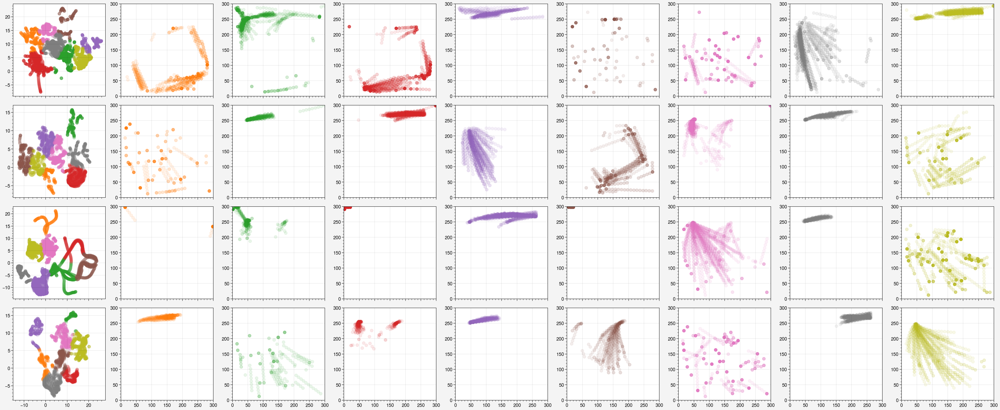

In [27]:
p = 0.4
t = 0

fig, ax = pplt.subplots(nrows=len(activ2ds), ncols=9, sharey=False)
for i in range(len(activ2ds)):
    pos = poss[i]
    activ2d = activ2ds[i]
    km = KMeans().fit(activ2d)
    labels = km.predict(activ2d)
    
    colored_activ2d_plot(activ2d, labels, pos, ax=ax[i, :])

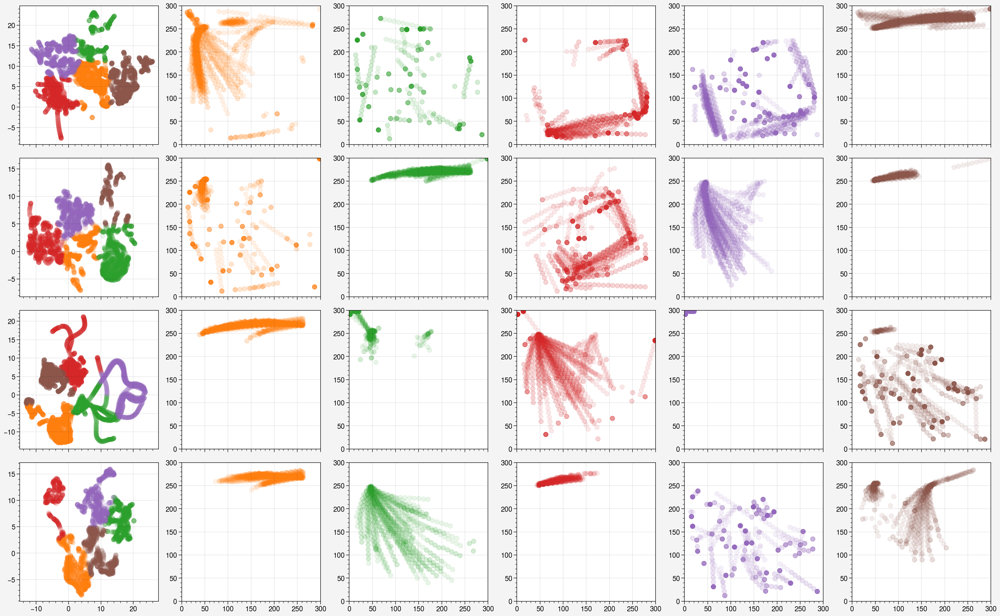

In [30]:
p = 0.4
t = 0
n_clusters = 5
fig, ax = pplt.subplots(nrows=len(activ2ds), ncols=n_clusters+1, sharey=False)

for i in range(len(activ2ds)):
    pos = poss[i]
    activ2d = activ2ds[i]
    km = KMeans(n_clusters=n_clusters).fit(activ2d)
    labels = km.predict(activ2d)
    
    colored_activ2d_plot(activ2d, labels, pos, ax=ax[i, :])

# Visual 2D clustering

## p=0.4 agents, policy

In [85]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

In [87]:
res['s

dict_keys(['pos', 'vis', 'shortcut_avail', 'shortcut_used', 'activ'])

In [88]:
poss = []
activ2ds = []
trial_idxs = []
shortcut_useds = []
trials = range(10)
for t in tqdm(trials):
    res = activs[f'0.4_{t}'][-1]
    activ = torch.vstack(res['activ'])
    if len(activ) < 10000:
        activ2d = UMAP(min_dist=0.35).fit_transform(activ)
        activ2ds.append(activ2d)
        pos = np.vstack(res['pos'])
        poss.append(pos)
        trial_idxs.append(t)
        shortcut_useds.append(res['shortcut_used'])
        


100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [00:47<00:00,  4.78s/it]


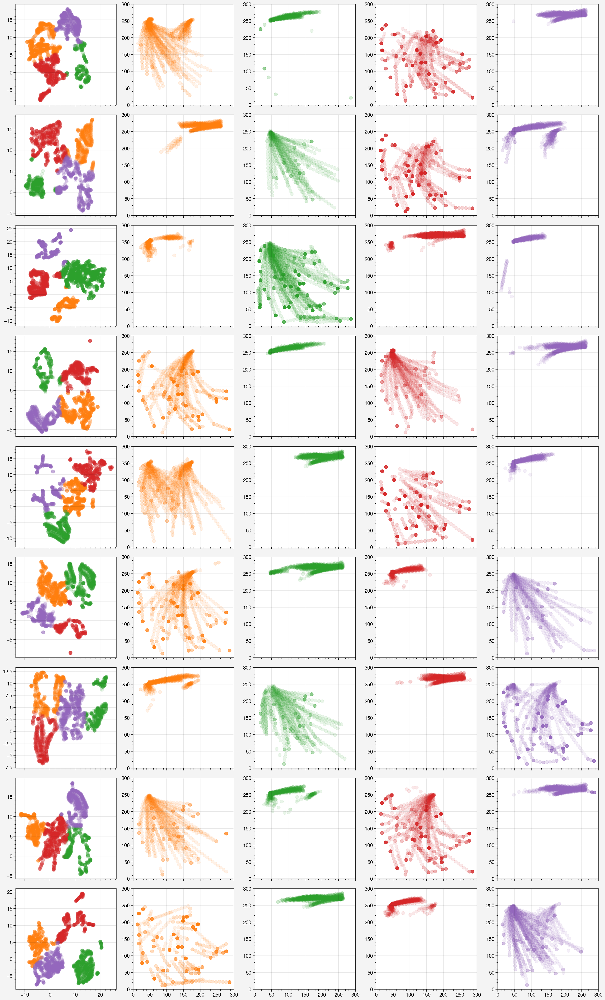

In [89]:
fig, ax = pplt.subplots(nrows=len(activ2ds), ncols=5, sharey=False)
for i in range(len(activ2ds)):
    pos = poss[i]
    activ2d = activ2ds[i]
    km = KMeans(n_clusters=4).fit(activ2d)
    labels = km.predict(activ2d)
    
    colored_activ2d_plot(activ2d, labels, pos, ax=ax[i, :])

### p=0.4 agents, policy, optimistic

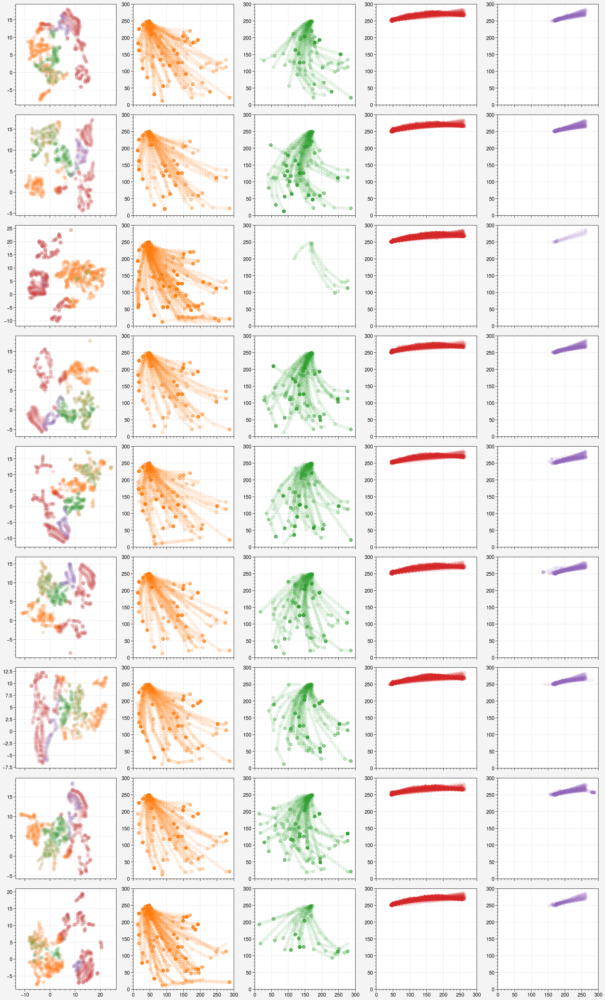

In [96]:
fig, ax = pplt.subplots(nrows=len(activ2ds), ncols=5, sharey=False)
for i in range(len(activ2ds)):
    trial_idx = trial_idxs[i]
    res = activs[f'0.4_{trial_idx}'][-1]
    activ2d = activ2ds[i]
    shortcut_used = np.squeeze(res['shortcut_used'])
    pos = res['pos']
    
    labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=shortcut_used)
    
    colored_activ2d_plot(activ2d, labels, np.vstack(pos), ax=ax[i, :], umap_alpha=0.02)

## p=0.1 agents, policy

In [12]:
poss = []
activ2ds = []
trials = range(10)
for t in tqdm(trials):
    res = activs[f'0.1_{t}'][-1]
    activ = torch.vstack(res['activ'])
    if len(activ) < 10000:
        activ2d = UMAP(min_dist=0.35).fit_transform(activ)
        activ2ds.append(activ2d)
        pos = np.vstack(res['pos'])
        poss.append(pos)


100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [00:27<00:00,  2.71s/it]


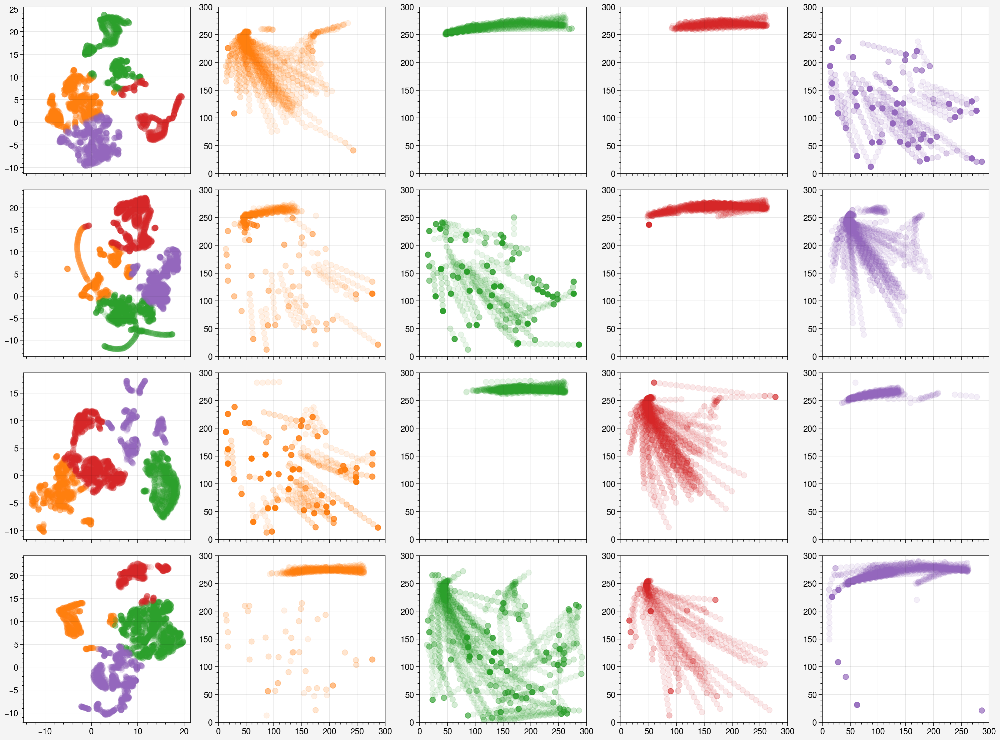

In [13]:
fig, ax = pplt.subplots(nrows=len(activ2ds), ncols=5, sharey=False)
for i in range(len(activ2ds)):
    pos = poss[i]
    activ2d = activ2ds[i]
    km = KMeans(n_clusters=4).fit(activ2d)
    labels = km.predict(activ2d)
    
    colored_activ2d_plot(activ2d, labels, pos, ax=ax[i, :])

## p=0.4 agents, copied

In [57]:
activs = pickle.load(open('data/shortcut/wc1.5_copied_moreagents/shared1_activ', 'rb'))

In [58]:
poss = []
activ2ds = []
trials = range(10)
for t in tqdm(trials):
    res = activs[f'0.4_{t}'][-1]
    activ = torch.vstack(res['activ'])
    if len(activ) < 10000:
        activ2d = UMAP(min_dist=0.35).fit_transform(activ)
        activ2ds.append(activ2d)
        pos = np.vstack(res['pos'])
        poss.append(pos)


100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [00:59<00:00,  5.91s/it]


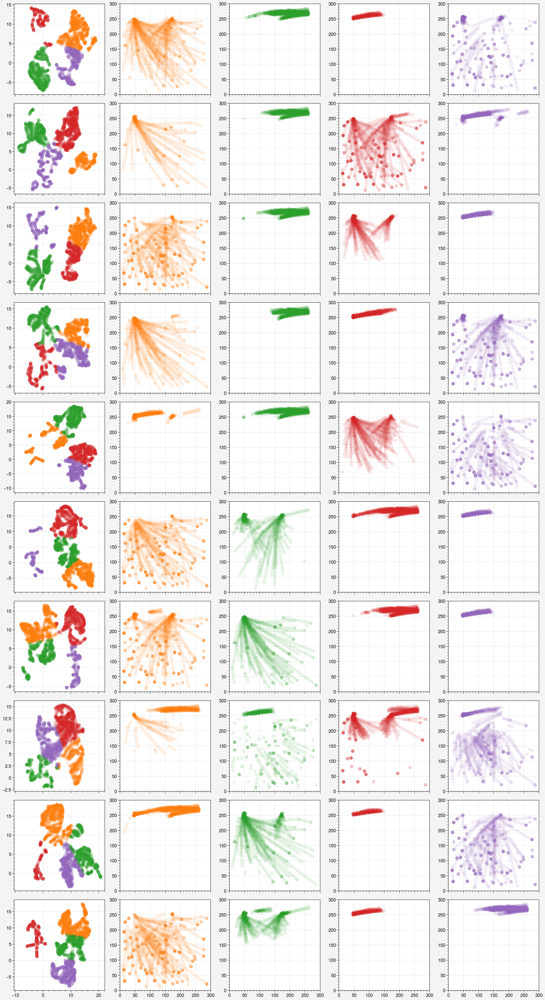

In [59]:
fig, ax = pplt.subplots(nrows=len(activ2ds), ncols=5, sharey=False)
for i in range(len(activ2ds)):
    pos = poss[i]
    activ2d = activ2ds[i]
    km = KMeans(n_clusters=4).fit(activ2d)
    labels = km.predict(activ2d)
    
    colored_activ2d_plot(activ2d, labels, pos, ax=ax[i, :])

## Clustering in full activation space prior to projection

In [60]:
activ.shape

torch.Size([4565, 64])

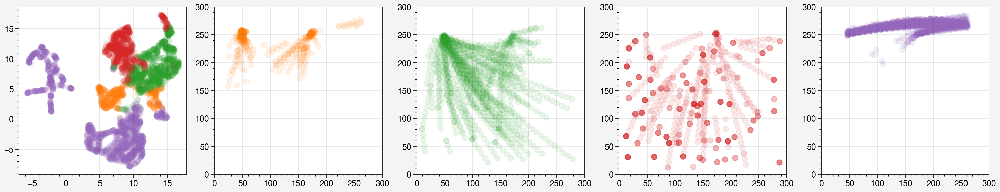

In [64]:
km = KMeans(n_clusters=4)
labels = km.fit_predict(activ)
colored_activ2d_plot(activ2d, labels, pos)

In [14]:
from sklearn.metrics import silhouette_score

In [15]:
activ2d = activ2ds[i]
km = KMeans(n_clusters=4).fit(activ2d)
labels = km.predict(activ2d)


In [16]:
silhouette_score(activ2d, labels)

0.52252084

# Data Collection

## wc1.5 p=0.1 longer copiedv2

In [265]:
chks = np.arange(500, 1560, 200)
print(chks, len(chks))


[ 500  700  900 1100 1300 1500] 6


In [266]:
fa = pickle.load(open('data/shortcut/forced_actions_v2', 'rb'))

# chks = np.arange(40, 470, 40)
chks = np.arange(500, 1560, 200)

num_episodes = 50
# probs = [0.1, 0.4]
probs = [0.1]

trials = range(10)
for x, (p, t) in enumerate(itertools.product(probs, trials)):
    all_res = {
        'ws': [],
        'ns': []
    }

    key = f'{p}_{t}_longer'
    for chk in tqdm(chks):
        model, obs_rms = load_chk(f'shortcut_wc1.5p{p}longer', subdir='shortcut_wc2', trial=t, chk=chk)

        res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
                               env_kwargs={'character_reset_pos': 3,
                                          'shortcut_probability': 0,
                                          'wall_colors': 1.5},
                           seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
                               num_episodes=num_episodes, forced_actions=fa['ns'])

        '''Collect up to first+nth step of seeing shortcut
        where first is the first step seeing the shortcut'''
        activs = ep_stack_activations(res, half=True)

        all_res['ns'].append({
            'activs': activs,
            'actions': res['actions'],
            'ep_pos': res['data']['pos'],
            'ep_angle': res['data']['angle'],
            'vis': res['data']['shortcut_vis'],
            'shortcut': res['data']['shortcut']
        })
        
        res = forced_action_evaluate(model, obs_rms, env_name='ShortcutNav-v0', 
                       env_kwargs={'character_reset_pos': 3,
                                  'shortcut_probability': 1,
                                  'wall_colors': 1.5},
                   seed=1, with_activations=True, data_callback=shortcut_visdata_callback,
                       num_episodes=num_episodes, forced_actions=fa['ws'])

        '''Collect up to first+nth step of seeing shortcut
        where first is the first step seeing the shortcut'''
        activs = ep_stack_activations(res, half=True)

        all_res['ws'].append({
            'activs': activs,
            'actions': res['actions'],
            'ep_pos': res['data']['pos'],
            'ep_angle': res['data']['angle'],
            'vis': res['data']['shortcut_vis'],
            'shortcut': res['data']['shortcut']
        })
        
    pickle.dump(all_res, open(f'data/shortcut/wc1.5_copiedv2_moreagents/{key}', 'wb'))

  0%|                                                                                      | 0/6 [00:00<?, ?it/s]


FileNotFoundError: [Errno 2] No such file or directory: '..\\saved_checkpoints\\shortcut_wc2\\shortcut_wc1.5p0.4longer_t0\\500.pt'

In [267]:
chks = np.arange(500, 1560, 200)
num_episodes = 50
probs = [0.1]
trials = range(10)

do_umap = True # flag to collect umaps

all_res = {}
for x, (p, t) in tqdm(enumerate(itertools.product(probs, trials)), total=20):
    
    
    key = f'{p}_{t}_longer'
    shortcut_res = pickle.load(open(f'data/shortcut/wc1.5_copiedv2_moreagents/{key}', 'rb'))
    all_res[key] = []
    for i in range(len(chks)):
        res1 = shortcut_res['ns'][i]
        res2 = shortcut_res['ws'][i]
        
        pos = res1['ep_pos'] + res2['ep_pos']
        angle = res1['ep_angle'] + res2['ep_angle']
        vis = res1['vis'] + res2['vis']
        shortcut_avail = res1['shortcut'] + res2['shortcut']
        shortcut_used = [[check_shortcut_usage(p)] for p in pos]
        activ = [a['shared_activations'][1] for a in res1['activs']] + \
                [a['shared_activations'][1] for a in res2['activs']]
        
        # add umap
        umap = UMAP(min_dist=0.35)
        activ2d = umap.fit_transform(np.vstack(activ)).astype('float16')
        
        all_res[key].append({
            'pos': pos,
            'angle': angle,
            'vis': vis,
            'shortcut_avail': shortcut_avail,
            'shortcut_used': shortcut_used,
            'activ': activ,
            'activ2d': activ2d
        })
        
    
pickle.dump(all_res, open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ_longer', 'wb'))

 50%|██████████████████████████████████████                                      | 10/20 [07:54<07:54, 47.50s/it]


# Collecting optimistic clustering silscores

## Orange vs green clusters

### Policy trajectories

In [51]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

silscores = {}
for key in tqdm(activs):
    chk_res = activs[key]
    silscores[key] = []
    for res in chk_res:
        pos = res['pos']
        shortcut_used = res['shortcut_used']
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=np.squeeze(shortcut_used))
        activ = torch.vstack(res['activ'])
        
        if (labels == 0).sum() < 1 or (labels == 1).sum() < 1:
            silscores[key].append(np.nan)
        else:
            silscores[key].append(two_set_silhouette_score(activ[labels == 0], activ[labels == 1]))
            
pickle.dump(silscores, open('data/shortcut/wc1.5_policy_moreagents/green_orange_silscores', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:33<00:00,  1.65s/it]


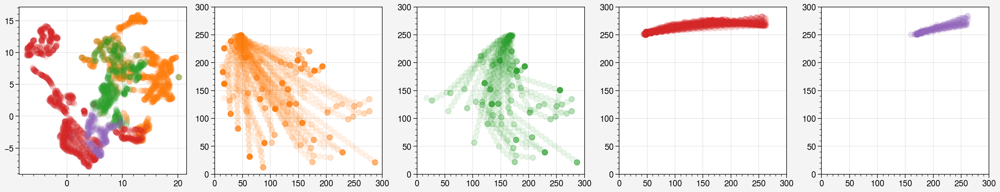

In [56]:
colored_activ2d_plot(activ2ds[-1], labels, np.vstack(pos))

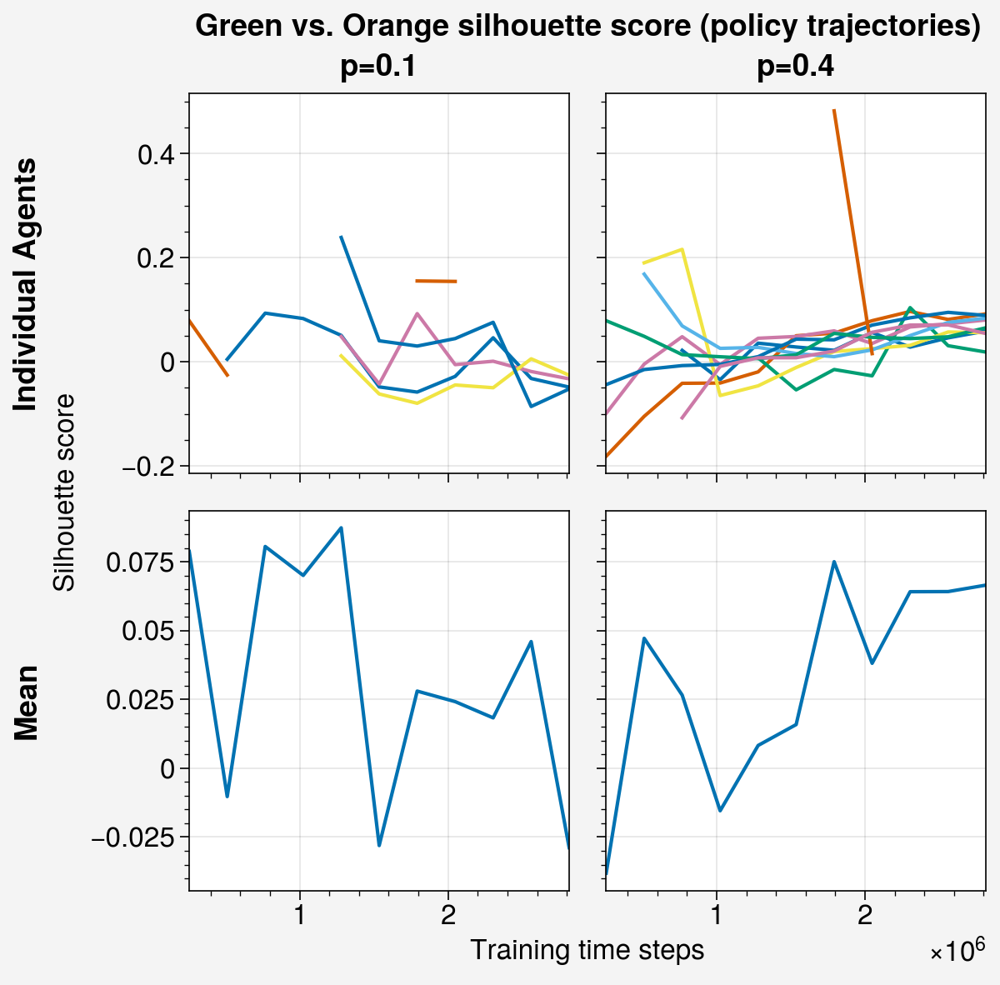

In [27]:
silscores = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/green_orange_silscores', 'rb'))

probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)

fig, ax = pplt.subplots(ncols=2, nrows=2, figwidth=6)
for i, p in enumerate(probs):
    if i == 0:
        x = chks*64*100/1000000
    else:
        x = chks*64*100
    
    sil = []
    for t in trials:
        ax[0, i].plot(x, silscores[f'{p}_{t}'])
        sil.append(silscores[f'{p}_{t}'])
        
    mean_sil = []
    for j in range(len(sil[0])):
        s = np.array(sil)[:, j]
        mean_sil.append(np.mean(s[~np.isnan(s)]))
    ax[1, i].plot(x, mean_sil)
    
ax.format(toplabels=[f'p={p}' for p in probs],
          leftlabels=['Individual Agents', 'Mean'],
          xlabel='Training time steps', ylabel='Silhouette score',
          suptitle='Green vs. Orange silhouette score (policy trajectories)')

### Copied trajectories

In [50]:
activs = pickle.load(open('data/shortcut/wc1.5_copied_moreagents/shared1_activ', 'rb'))

silscores = {}
for key in tqdm(activs):
    chk_res = activs[key]
    silscores[key] = []
    for res in chk_res:
        pos = res['pos']
        shortcut_used = res['shortcut_used']
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=np.squeeze(shortcut_used))
        activ = torch.vstack(res['activ'])
        
        if (labels == 0).sum() < 1 or (labels == 1).sum() < 1:
            silscores[key].append(np.nan)
        else:
            silscores[key].append(two_set_silhouette_score(activ[labels == 0], activ[labels == 1]))
            
pickle.dump(silscores, open('data/shortcut/wc1.5_copied_moreagents/green_orange_silscores', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:30<00:00,  1.52s/it]


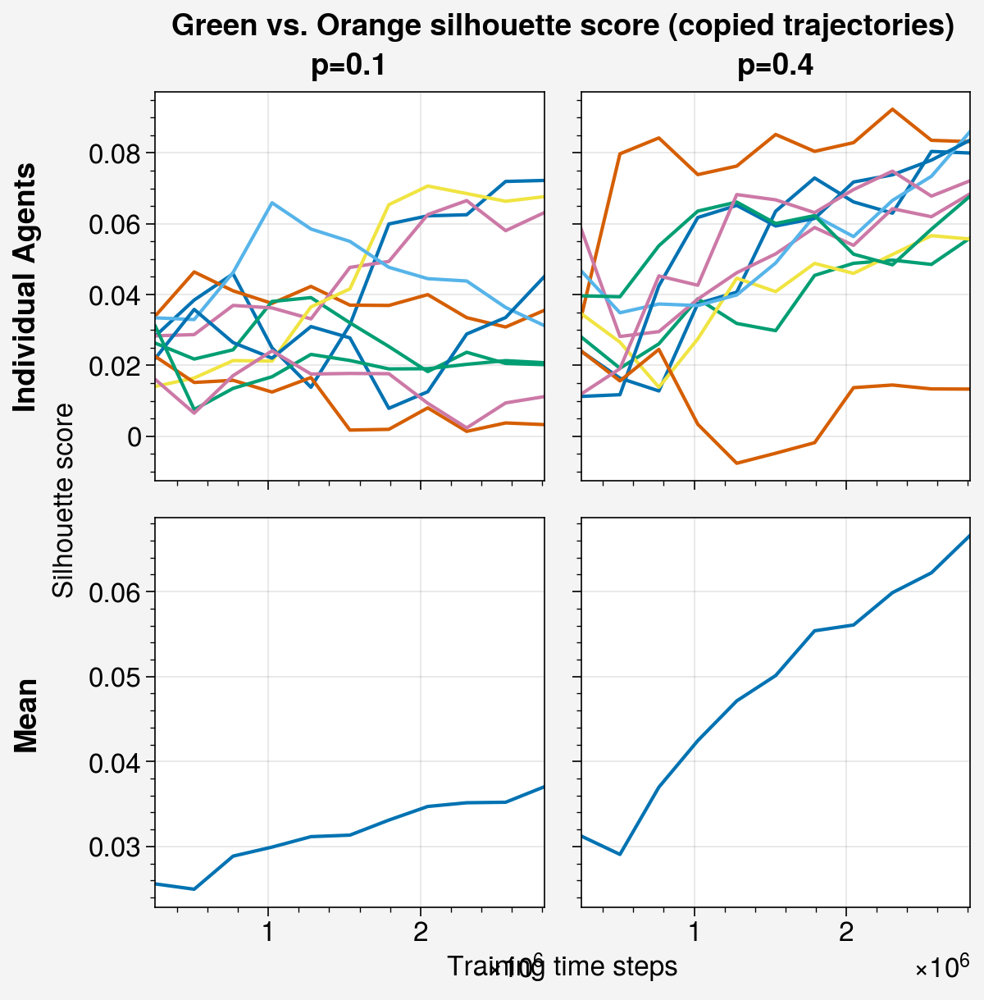

In [105]:
silscores = pickle.load(open('data/shortcut/wc1.5_copied_moreagents/green_orange_silscores', 'rb'))

probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)

fig, ax = pplt.subplots(ncols=2, nrows=2, figwidth=6)
for i, p in enumerate(probs):
    sil = []
    for t in trials:
        ax[0, i].plot(chks*64*100, silscores[f'{p}_{t}'])
        sil.append(silscores[f'{p}_{t}'])
        
    mean_sil = []
    for j in range(len(sil[0])):
        s = np.array(sil)[:, j]
        mean_sil.append(np.mean(s[~np.isnan(s)]))
    ax[1, i].plot(chks*64*100, mean_sil)
    
ax.format(toplabels=[f'p={p}' for p in probs],
          leftlabels=['Individual Agents', 'Mean'],
          xlabel='Training time steps', ylabel='Silhouette score',
          suptitle='Green vs. Orange silhouette score (copied trajectories)')

## All clusters silhouette score

### Policy trajectories

In [25]:
silscores = {}
for key in tqdm(activs):
    chk_res = activs[key]
    silscores[key] = []
    for res in chk_res:
        pos = res['pos']
        shortcut_used = res['shortcut_used']
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=np.squeeze(shortcut_used))
        activ = torch.vstack(res['activ'])
        if len(np.unique(labels)) < 2:
            silscores[key].append(np.nan)
        else:
            silscores[key].append(silhouette_score(activ, labels))
            
pickle.dump(silscores, open('data/shortcut/wc1.5_policy_moreagents/combo_silscores', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [07:03<00:00, 21.19s/it]


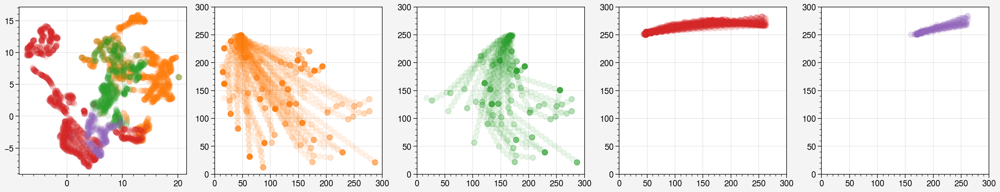

In [56]:
colored_activ2d_plot(activ2ds[-1], labels, np.vstack(pos))

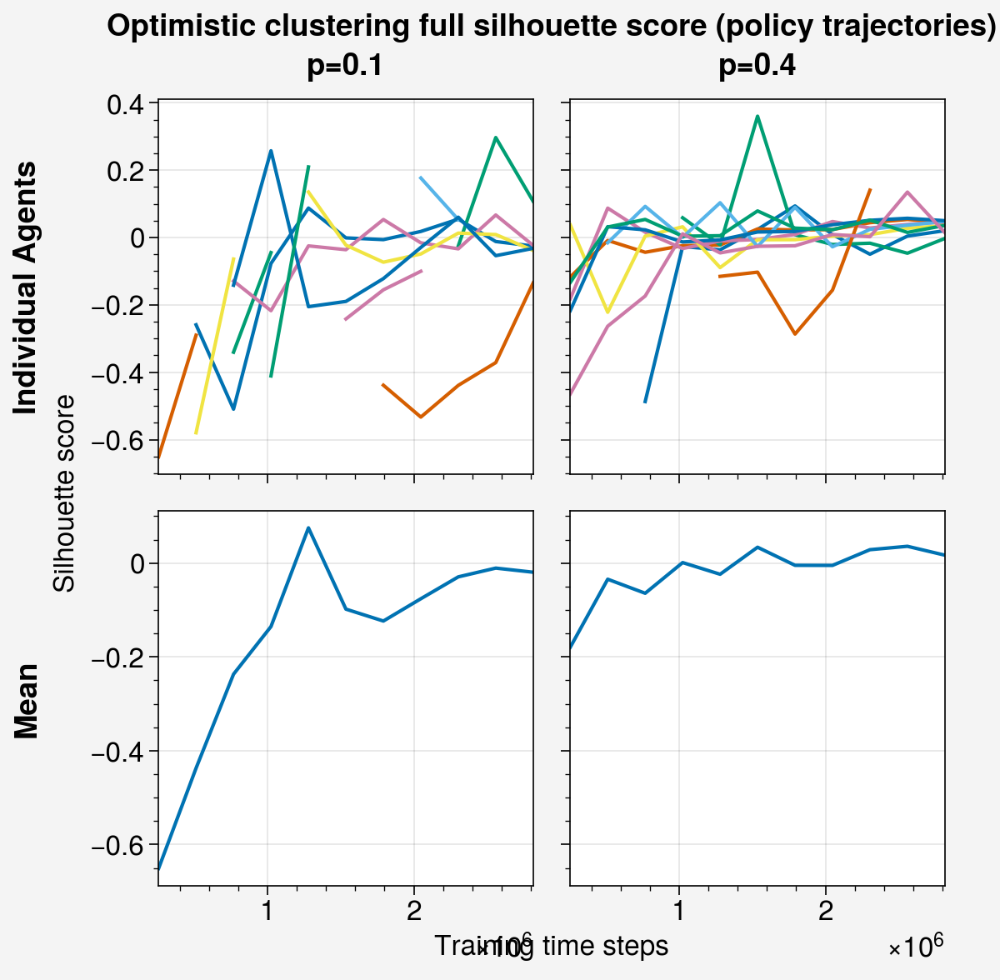

In [107]:
silscores = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/combo_silscores', 'rb'))

probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)

fig, ax = pplt.subplots(ncols=2, nrows=2, figwidth=6)

for i, p in enumerate(probs):
    sil = []
    for t in trials:
        ax[0, i].plot(chks*64*100, silscores[f'{p}_{t}'])
        sil.append(silscores[f'{p}_{t}'])
        
    mean_sil = []
    for j in range(len(sil[0])):
        s = np.array(sil)[:, j]
        mean_sil.append(np.mean(s[~np.isnan(s)]))
    ax[1, i].plot(chks*64*100, mean_sil)
    
ax.format(toplabels=[f'p={p}' for p in probs],
          leftlabels=['Individual Agents', 'Mean'],
          xlabel='Training time steps', ylabel='Silhouette score',
          suptitle='Optimistic clustering full silhouette score (policy trajectories)')

### Copied trajectories

In [48]:
activs = pickle.load(open('data/shortcut/wc1.5_copied_moreagents/shared1_activ', 'rb'))

silscores = {}
for key in tqdm(activs):
    chk_res = activs[key]
    silscores[key] = []
    for res in chk_res:
        pos = res['pos']
        shortcut_used = res['shortcut_used']
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=np.squeeze(shortcut_used))
        activ = torch.vstack(res['activ'])
        if len(np.unique(labels)) < 2:
            silscores[key].append(np.nan)
        else:
            silscores[key].append(silhouette_score(activ, labels))
            
pickle.dump(silscores, open('data/shortcut/wc1.5_copied_moreagents/combo_silscores', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [01:18<00:00,  3.95s/it]


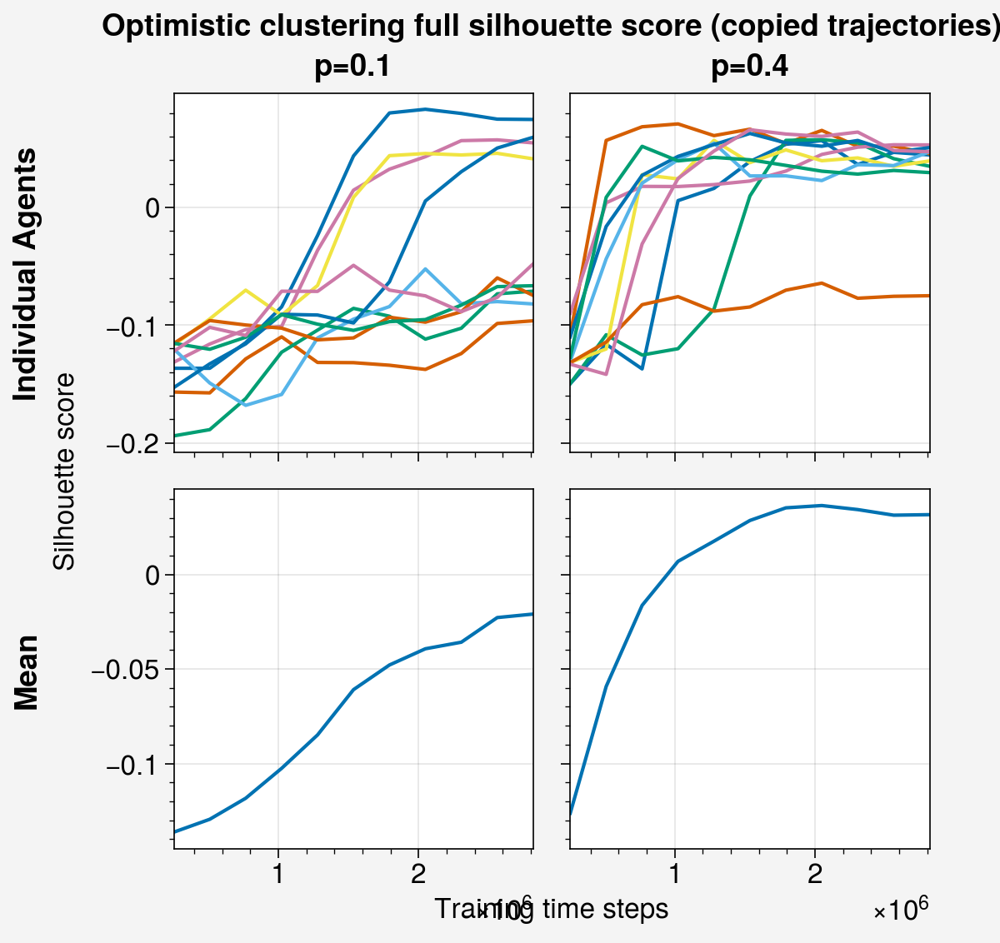

In [108]:
silscores = pickle.load(open('data/shortcut/wc1.5_copied_moreagents/combo_silscores', 'rb'))

probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)

fig, ax = pplt.subplots(ncols=2, nrows=2, figwidth=6)
for i, p in enumerate(probs):
    sil = []
    for t in trials:
        ax[0, i].plot(chks*64*100, silscores[f'{p}_{t}'])
        sil.append(silscores[f'{p}_{t}'])
        
    mean_sil = []
    for j in range(len(sil[0])):
        s = np.array(sil)[:, j]
        mean_sil.append(np.mean(s[~np.isnan(s)]))
    ax[1, i].plot(chks*64*100, mean_sil)
    
ax.format(toplabels=[f'p={p}' for p in probs],
          leftlabels=['Individual Agents', 'Mean'],
          xlabel='Training time steps', ylabel='Silhouette score',
          suptitle='Optimistic clustering full silhouette score (copied trajectories)')

# Collecting optimistic clustering wasserstein distances

## Orange vs green clusters

### Policy trajectories

In [20]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

silscores = {}
for key in tqdm(activs):
    chk_res = activs[key]
    silscores[key] = []
    for res in chk_res:
        pos = res['pos']
        shortcut_used = res['shortcut_used']
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=np.squeeze(shortcut_used))
        activ = np.vstack(res['activ'])
        
        if (labels == 0).sum() < 1 or (labels == 1).sum() < 1:
            silscores[key].append(np.nan)
        else:
            silscores[key].append(two_cloud_wasserstein(activ[labels == 0], activ[labels == 1], all_data=activ)[0])
            
pickle.dump(silscores, open('data/shortcut/wc1.5_policy_moreagents/green_orange_wassersteins', 'wb'))

100%|████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:29<00:00,  1.50s/it]


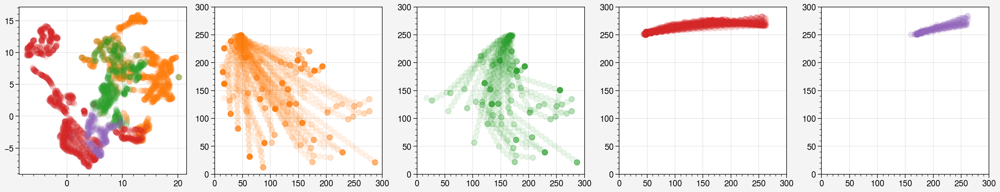

In [56]:
colored_activ2d_plot(activ2ds[-1], labels, np.vstack(pos))

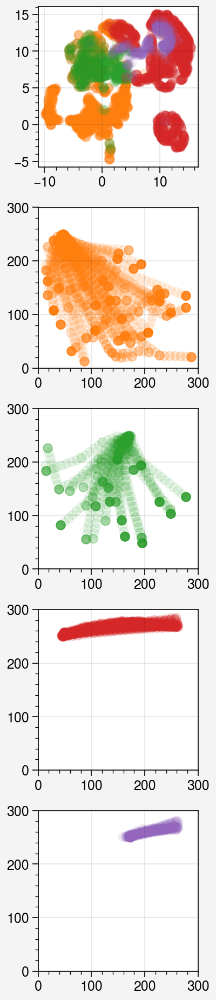

In [252]:
res = activs['0.4_0'][9]

activ2d = res['activ2d']
pos = res['pos']
used = res['shortcut_used']

labels, _ = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=used)
fig, ax = pplt.subplots(nrows=5, figwidth=2, sharex=False)
colored_activ2d_plot(np.vstack(activ2d), labels, np.vstack(pos), ax=ax)

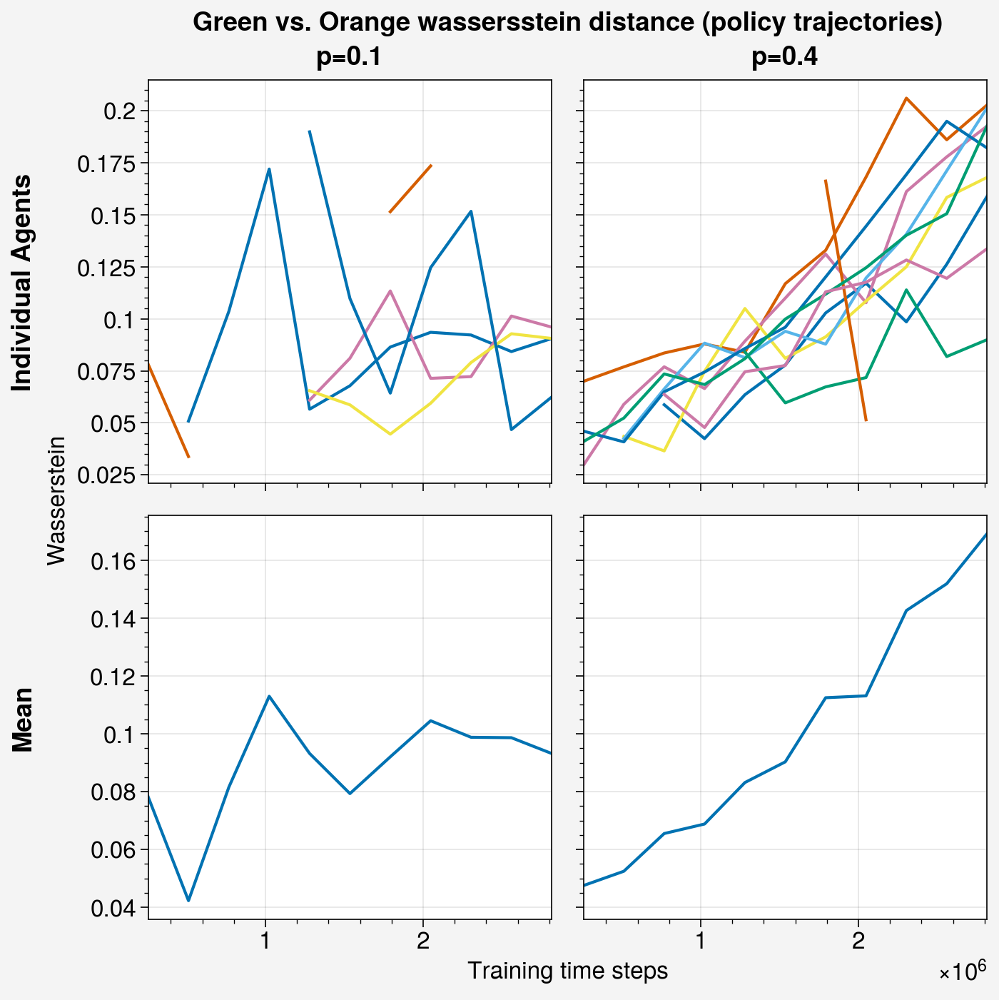

In [25]:
silscores = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/green_orange_wassersteins', 'rb'))

probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)

fig, ax = pplt.subplots(ncols=2, nrows=2, figwidth=7)
for i, p in enumerate(probs):
    if i == 0:
        x = chks*64*100/1000000
    else:
        x = chks*64*100
    
    sil = []
    for t in trials:
        ax[0, i].plot(x, silscores[f'{p}_{t}'])
        sil.append(silscores[f'{p}_{t}'])
        
    mean_sil = []
    for j in range(len(sil[0])):
        s = np.array(sil)[:, j]
        mean_sil.append(np.mean(s[~np.isnan(s)]))
    ax[1, i].plot(x, mean_sil)
    
ax.format(toplabels=[f'p={p}' for p in probs],
          leftlabels=['Individual Agents', 'Mean'],
          xlabel='Training time steps', ylabel='Wasserstein',
          suptitle='Green vs. Orange wassersstein distance (policy trajectories)')

### Copied trajectories

In [21]:
activs = pickle.load(open('data/shortcut/wc1.5_copied_moreagents/shared1_activ', 'rb'))

silscores = {}
for key in tqdm(activs):
    chk_res = activs[key]
    silscores[key] = []
    for res in chk_res:
        pos = res['pos']
        shortcut_used = res['shortcut_used']
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=np.squeeze(shortcut_used))
        activ = np.vstack(res['activ'])
        
        if (labels == 0).sum() < 1 or (labels == 1).sum() < 1:
            silscores[key].append(np.nan)
        else:
            silscores[key].append(two_cloud_wasserstein(activ[labels == 0], activ[labels == 1], all_data=activ)[0])
            
pickle.dump(silscores, open('data/shortcut/wc1.5_copied_moreagents/green_orange_wassersteins', 'wb'))

100%|████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:42<00:00,  2.11s/it]


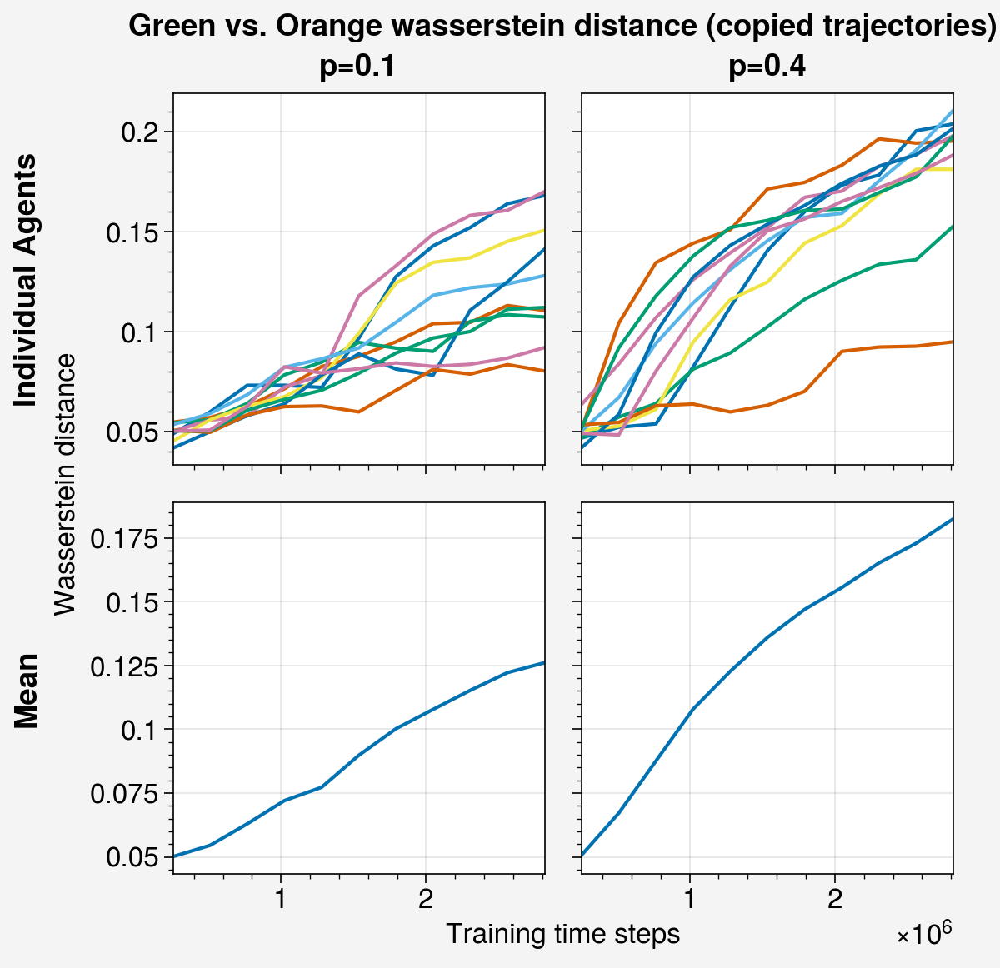

In [26]:
silscores = pickle.load(open('data/shortcut/wc1.5_copied_moreagents/green_orange_wassersteins', 'rb'))

probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)

fig, ax = pplt.subplots(ncols=2, nrows=2, figwidth=6)
for i, p in enumerate(probs):
    if i == 0:
        x = chks*64*100/1000000
    else:
        x = chks*64*100
    
    sil = []
    for t in trials:
        ax[0, i].plot(x, silscores[f'{p}_{t}'])
        sil.append(silscores[f'{p}_{t}'])
        
    mean_sil = []
    for j in range(len(sil[0])):
        s = np.array(sil)[:, j]
        mean_sil.append(np.mean(s[~np.isnan(s)]))
    ax[1, i].plot(x, mean_sil)
    
ax.format(toplabels=[f'p={p}' for p in probs],
          leftlabels=['Individual Agents', 'Mean'],
          xlabel='Training time steps', ylabel='Wasserstein distance',
          suptitle='Green vs. Orange wasserstein distance (copied trajectories)')

### Copied v2

In [28]:
activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ', 'rb'))

silscores = {}
for key in tqdm(activs):
    chk_res = activs[key]
    silscores[key] = []
    for res in chk_res:
        pos = res['pos']
        shortcut_used = res['shortcut_used']
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=np.squeeze(shortcut_used))
        activ = np.vstack(res['activ'])
        
        if (labels == 0).sum() < 1 or (labels == 1).sum() < 1:
            silscores[key].append(np.nan)
        else:
            silscores[key].append(two_cloud_wasserstein(activ[labels == 0], activ[labels == 1], all_data=activ)[0])
            
pickle.dump(silscores, open('data/shortcut/wc1.5_copiedv2_moreagents/green_orange_wassersteins', 'wb'))

100%|████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:56<00:00,  2.80s/it]


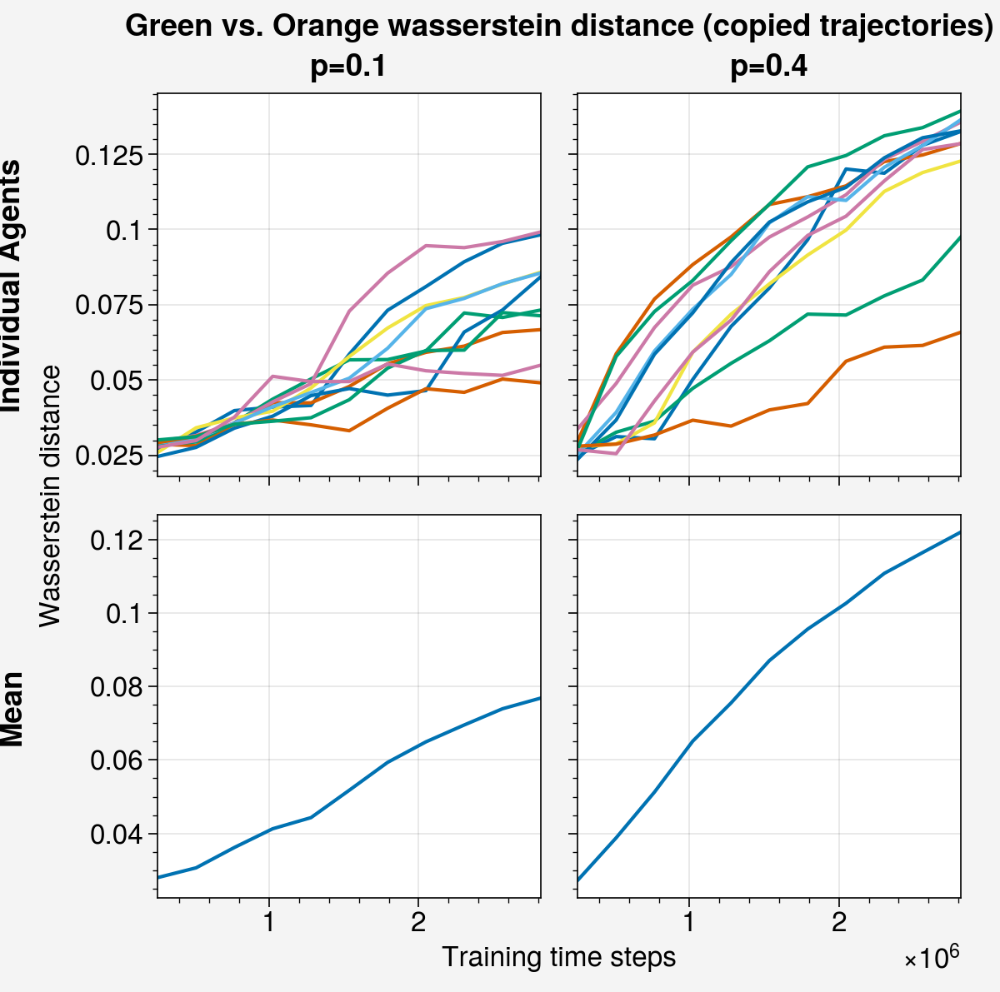

In [29]:
silscores = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/green_orange_wassersteins', 'rb'))

probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)

fig, ax = pplt.subplots(ncols=2, nrows=2, figwidth=6)
for i, p in enumerate(probs):
    if i == 0:
        x = chks*64*100/1000000
    else:
        x = chks*64*100
    
    sil = []
    for t in trials:
        ax[0, i].plot(x, silscores[f'{p}_{t}'])
        sil.append(silscores[f'{p}_{t}'])
        
    mean_sil = []
    for j in range(len(sil[0])):
        s = np.array(sil)[:, j]
        mean_sil.append(np.mean(s[~np.isnan(s)]))
    ax[1, i].plot(x, mean_sil)
    
ax.format(toplabels=[f'p={p}' for p in probs],
          leftlabels=['Individual Agents', 'Mean'],
          xlabel='Training time steps', ylabel='Wasserstein distance',
          suptitle='Green vs. Orange wasserstein distance (copied trajectories)')

## Collecting all pairwise Wassersteins

### Policy

In [26]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

num_chks = len(activs['0.4_0'])

wassersteins = {}
for key in tqdm(activs):
    chk_res = activs[key]
    wassersteins[key] = np.full((num_chks, 4, 4), np.nan)
    
    for chk, res in enumerate(chk_res):
        pos = res['pos']
        shortcut_used = res['shortcut_used']
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=np.squeeze(shortcut_used))
        activ = np.vstack(res['activ'])
        
        for i, j in itertools.combinations(range(4), 2):
            if (labels == i).sum() < 1 or (labels == j).sum() < 1:
                wassersteins[key][chk, i, j] = np.nan
            else:
                wassersteins[key][chk, i, j] = two_cloud_wasserstein(activ[labels == i],
                                                                     activ[labels == j],
                                                                     all_data=activ)[0]
            
pickle.dump(wassersteins, open('data/shortcut/wc1.5_policy_moreagents/pair_wassersteins', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [22:10<00:00, 66.50s/it]


### Copied

In [27]:
activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ', 'rb'))

num_chks = len(activs['0.4_0'])

wassersteins = {}
for key in tqdm(activs):
    chk_res = activs[key]
    wassersteins[key] = np.full((num_chks, 4, 4), np.nan)
    
    for chk, res in enumerate(chk_res):
        pos = res['pos']
        shortcut_used = res['shortcut_used']
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, ep_shortcut_used=np.squeeze(shortcut_used))
        activ = np.vstack(res['activ'])
        
        for i, j in itertools.combinations(range(4), 2):
            if (labels == i).sum() < 1 or (labels == j).sum() < 1:
                wassersteins[key][chk, i, j] = np.nan
            else:
                wassersteins[key][chk, i, j] = two_cloud_wasserstein(activ[labels == i],
                                                                     activ[labels == j],
                                                                     all_data=activ)[0]
            
pickle.dump(wassersteins, open('data/shortcut/wc1.5_copiedv2_moreagents/pair_wassersteins', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [14:22<00:00, 43.13s/it]


### Copied, open shortcut only

In [87]:
activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ', 'rb'))

num_chks = len(activs['0.4_0'])

wassersteins = {}
for key in tqdm(activs):
    chk_res = activs[key]
    wassersteins[key] = np.full((num_chks, 4, 4), np.nan)
    
    for chk, res in enumerate(chk_res):
        pos = res['pos'][50:]
        activ = np.vstack(res['activ'][50:])
        shortcut_used = res['shortcut_used'][50:]
        labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, 
                                                             ep_shortcut_used=np.squeeze(shortcut_used))
        
        for i, j in itertools.combinations(range(4), 2):
            if (labels == i).sum() < 1 or (labels == j).sum() < 1:
                wassersteins[key][chk, i, j] = np.nan
            else:
                wassersteins[key][chk, i, j] = two_cloud_wasserstein(activ[labels == i],
                                                                     activ[labels == j],
                                                                     all_data=activ)[0]
            
pickle.dump(wassersteins, open('data/shortcut/wc1.5_copiedv2_moreagents/pair_wassersteins_openshortcut', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [01:48<00:00,  5.44s/it]


## Closed/Seen/Taken cluster Wassersteins

Consider splitting the pre-corridor trajectory steps to closed/seen/taken rather than the shortcut vs. entrance path. Only consider these clusters and their wassersteins

### Policy

In [10]:
n_to_id = ['cvs', 'cvt', 'svt'] # convert enumeration in itertools combination
for n, (i, j) in enumerate(itertools.combinations(range(3), 2)):
    print(n_to_id[n], i, j)

cvs 0 1
cvt 0 2
svt 1 2


In [11]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

num_chks = len(activs['0.4_0'])

wassersteins = {}
for key in tqdm(activs):
    chk_res = activs[key]
    wassersteins[key] = {'cvs': [], 'cvt': [], 'svt': []}
    n_to_id = ['cvs', 'cvt', 'svt'] # convert enumeration in itertools combination
        # loop to the correct key in wassersteins dict
    
    for chk, res in enumerate(chk_res):
        pos = res['pos']
        avail = res['shortcut_avail']
        used = res['shortcut_used']
        color = closed_seen_taken_coloring(pos, avail, used)
        activ = np.vstack(res['activ'])
                    
        for n, (i, j) in enumerate(itertools.combinations(range(3), 2)):
            if (color == i).sum() < 1 or (color == j).sum() < 1:
                score = np.nan
            elif (color == i).sum() > 4000 and (color == j).sum() > 4000:
                score = np.nan # too many comparisons, will be very slow
            else:
                score = two_cloud_wasserstein(activ[color == i],
                                             activ[color == j],
                                             all_data=activ)[0]
            wassersteins[key][n_to_id[n]].append(score)
            
pickle.dump(wassersteins, open('data/shortcut/wc1.5_policy_moreagents/cst_wassersteins', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [01:13<00:00,  3.68s/it]


### Copied v2

In [28]:
activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ', 'rb'))

num_chks = len(activs['0.4_0'])

wassersteins = {}
for key in tqdm(activs):
    chk_res = activs[key]
    wassersteins[key] = {'cvs': [], 'cvt': [], 'svt': []}
    n_to_id = ['cvs', 'cvt', 'svt'] # convert enumeration in itertools combination
        # loop to the correct key in wassersteins dict
    
    for chk, res in enumerate(chk_res):
        pos = res['pos']
        avail = res['shortcut_avail']
        used = res['shortcut_used']
        color = closed_seen_taken_coloring(pos, avail, used)
        activ = np.vstack(res['activ'])
                    
        for n, (i, j) in enumerate(itertools.combinations(range(3), 2)):
            if (color == i).sum() < 1 or (color == j).sum() < 1:
                score = np.nan
            elif (color == i).sum() > 4000 and (color == j).sum() > 4000:
                score = np.nan # too many comparisons, will be very slow
            else:
                score = two_cloud_wasserstein(activ[color == i],
                                             activ[color == j],
                                             all_data=activ)[0]
            wassersteins[key][n_to_id[n]].append(score)
            
pickle.dump(wassersteins, open('data/shortcut/wc1.5_copiedv2_moreagents/cst_wassersteins', 'wb'))

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [01:29<00:00,  4.49s/it]


### Copied v2 - longer training checkpoints 500-1500

In [268]:
activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ_longer', 'rb'))
chks = np.arange(500, 1560, 200)
num_chks = len(chks)

wassersteins = {}
for key in tqdm(activs):
    chk_res = activs[key]
    wassersteins[key] = {'cvs': [], 'cvt': [], 'svt': []}
    n_to_id = ['cvs', 'cvt', 'svt'] # convert enumeration in itertools combination
        # loop to the correct key in wassersteins dict
    
    for chk, res in enumerate(chk_res):
        pos = res['pos']
        avail = res['shortcut_avail']
        used = res['shortcut_used']
        color = closed_seen_taken_coloring(pos, avail, used)
        activ = np.vstack(res['activ'])
                    
        for n, (i, j) in enumerate(itertools.combinations(range(3), 2)):
            if (color == i).sum() < 1 or (color == j).sum() < 1:
                score = np.nan
            elif (color == i).sum() > 4000 and (color == j).sum() > 4000:
                score = np.nan # too many comparisons, will be very slow
            else:
                score = two_cloud_wasserstein(activ[color == i],
                                             activ[color == j],
                                             all_data=activ)[0]
            wassersteins[key][n_to_id[n]].append(score)
            
pickle.dump(wassersteins, open('data/shortcut/wc1.5_copiedv2_moreagents/cst_wassersteins_longer', 'wb'))

100%|████████████████████████████████████████████████████████████████████████████| 10/10 [00:29<00:00,  2.98s/it]


## Early middle late cluster matrix

### Policy

In [160]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/pair_wassersteins', 'rb'))


C:\Users\14and\AppData\Local\Temp\ipykernel_22360\1594903386.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)
C:\Users\14and\AppData\Local\Temp\ipykernel_22360\1594903386.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)
C:\Users\14and\AppData\Local\Temp\ipykernel_22360\1594903386.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)


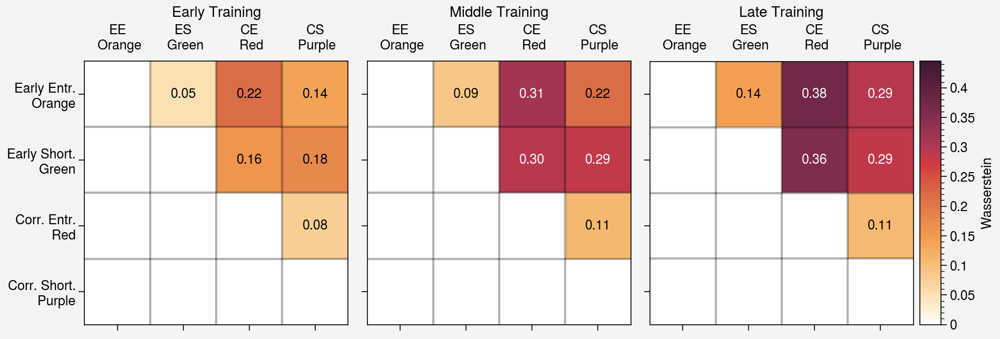

In [251]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/pair_wassersteins', 'rb'))

probs = [0.1, 0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=3)

# Get largest score to scale by
max_score = 0
for i, (p, t) in enumerate(itertools.product(probs, trials)):
    key = f'{p}_{t}'
    w = wassersteins[key][chk]
    if np.isnan(w).all():
        continue
    score = np.nanmax(w)
    if score > max_score:
        max_score = score


plot_chks = [1, 5, 10]
for n, chk in enumerate(plot_chks):
    
    # Gather up wasserstein scores to take a mean
    w_matrix = []
    for i, (p, t) in enumerate(itertools.product(probs, trials)):
        key = f'{p}_{t}'
        w = wassersteins[key][chk]
        if not np.isnan(w).all():
            w_matrix.append(w)
    w_matrix = np.stack(w_matrix)
    w = np.nanmean(w_matrix, axis=0)
    
    # plot matrix
    cbar = ax[n].imshow(w, vmin=0, vmax=max_score)

    for i, j in itertools.combinations(range(4), 2):
        score = w[i, j]
        color = 'white' if score > max_score/2 else 'black'
        ax[n].text(j, i, f'{score:.2f}', ha='center', va='center', color=color)

        
    for i in range(3):
        ax[n].plot([-0.5, 3.5], [i+0.5, i+0.5], color='k', alpha=0.3)
        ax[n].plot([i+0.5, i+0.5], [-0.5, 3.5], color='k', alpha=0.3)


labels = ['Early Entr.\n Orange', 'Early Short.\n Green','Corr. Entr.\n Red', 'Corr. Short.\n Purple']
labels_short = ['EE\n Orange', 'ES\n Green','CE\n Red', 'CS\n Purple']
ax[-1].colorbar(cbar, label='Wasserstein')
ax.format(xformatter=labels_short, xlocator=np.arange(5), xgrid=False, 
          xrotation=0, xticklabelloc='top',
          yformatter=labels, ylocator=range(5), ygrid=False,
          title=['Early Training', 'Middle Training', 'Late Training'])


### Copied

C:\Users\14and\AppData\Local\Temp\ipykernel_25028\2269506897.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)
C:\Users\14and\AppData\Local\Temp\ipykernel_25028\2269506897.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)
C:\Users\14and\AppData\Local\Temp\ipykernel_25028\2269506897.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)


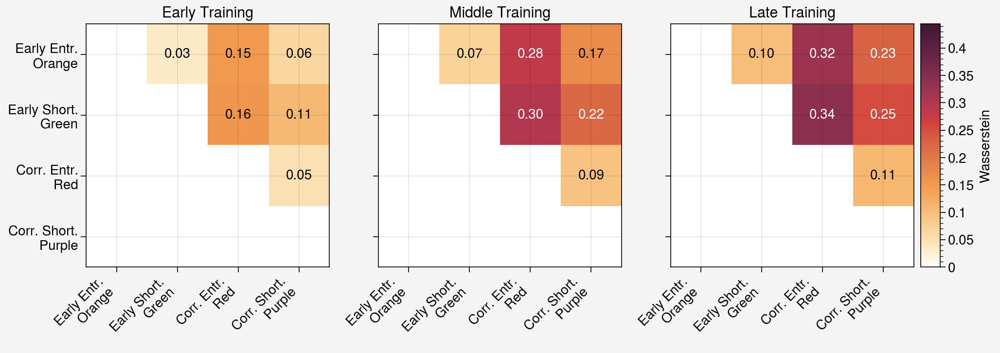

In [93]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/pair_wassersteins', 'rb'))

probs = [0.1, 0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=3)

# Get largest score to scale by
max_score = 0
for i, (p, t) in enumerate(itertools.product(probs, trials)):
    key = f'{p}_{t}'
    w = wassersteins[key][chk]
    if np.isnan(w).all():
        continue
    score = np.nanmax(w)
    if score > max_score:
        max_score = score


plot_chks = [1, 5, 10]
for n, chk in enumerate(plot_chks):
    
    # Gather up wasserstein scores to take a mean
    w_matrix = []
    for i, (p, t) in enumerate(itertools.product(probs, trials)):
        key = f'{p}_{t}'
        w = wassersteins[key][chk]
        if not np.isnan(w).all():
            w_matrix.append(w)
    w_matrix = np.stack(w_matrix)
    w = np.nanmean(w_matrix, axis=0)
    
    # plot matrix
    cbar = ax[n].imshow(w, vmin=0, vmax=max_score)

    for i, j in itertools.combinations(range(4), 2):
        score = w[i, j]
        color = 'white' if score > max_score/2 else 'black'
        ax[n].text(j, i, f'{score:.2f}', ha='center', va='center', color=color)

labels = ['Early Entr.\n Orange', 'Early Short.\n Green','Corr. Entr.\n Red', 'Corr. Short.\n Purple']
ax[-1].colorbar(cbar, label='Wasserstein')
ax.format(xformatter=labels, xlocator=range(5),
          xrotation=45,
          yformatter=labels, ylocator=range(5),
          title=['Early Training', 'Middle Training', 'Late Training'])



### Copied only consider open shortcuts

C:\Users\14and\AppData\Local\Temp\ipykernel_25028\3671597008.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)
C:\Users\14and\AppData\Local\Temp\ipykernel_25028\3671597008.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)
C:\Users\14and\AppData\Local\Temp\ipykernel_25028\3671597008.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)


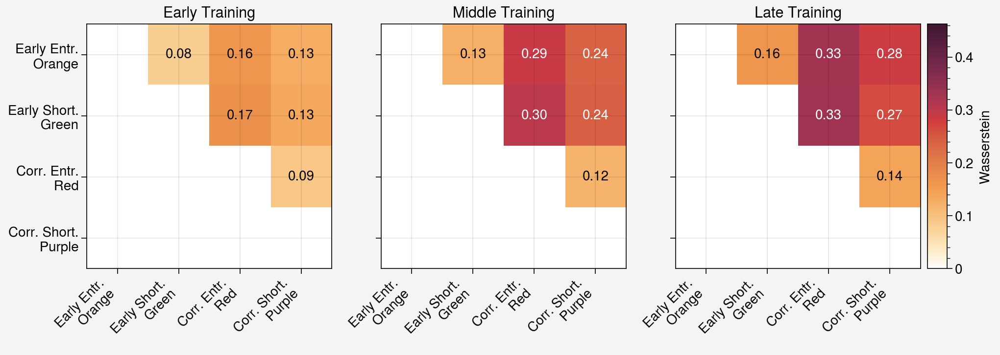

In [91]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/pair_wassersteins_openshortcut', 'rb'))

probs = [0.1, 0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=3)

# Get largest score to scale by
max_score = 0
for i, (p, t) in enumerate(itertools.product(probs, trials)):
    key = f'{p}_{t}'
    w = wassersteins[key][chk]
    if np.isnan(w).all():
        continue
    score = np.nanmax(w)
    if score > max_score:
        max_score = score


plot_chks = [1, 5, 10]
for n, chk in enumerate(plot_chks):
    
    # Gather up wasserstein scores to take a mean
    w_matrix = []
    for i, (p, t) in enumerate(itertools.product(probs, trials)):
        key = f'{p}_{t}'
        w = wassersteins[key][chk]
        if not np.isnan(w).all():
            w_matrix.append(w)
    w_matrix = np.stack(w_matrix)
    w = np.nanmean(w_matrix, axis=0)
    
    # plot matrix
    cbar = ax[n].imshow(w, vmin=0, vmax=max_score)

    for i, j in itertools.combinations(range(4), 2):
        score = w[i, j]
        color = 'white' if score > max_score/2 else 'black'
        ax[n].text(j, i, f'{score:.2f}', ha='center', va='center', color=color)

labels = ['Early Entr.\n Orange', 'Early Short.\n Green','Corr. Entr.\n Red', 'Corr. Short.\n Purple']
ax[-1].colorbar(cbar, label='Wasserstein')
ax.format(xformatter=labels, xlocator=range(5),
          xrotation=45,
          yformatter=labels, ylocator=range(5),
          title=['Early Training', 'Middle Training', 'Late Training'])


In [253]:
cop_activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ', 'rb'))
pol_activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

In [ ]:
labels, no_cluster = decompose_shortcut_trajectories(ep_pos=pos, 
                                                     ep_shortcut_used=np.squeeze(shortcut_used))


### Closed/Seen/Taken below corridor - policy

C:\Users\14and\AppData\Local\Temp\ipykernel_22360\2014380986.py:16: RuntimeWarning: Mean of empty slice
  vals = np.nanmean(vals, axis=0)


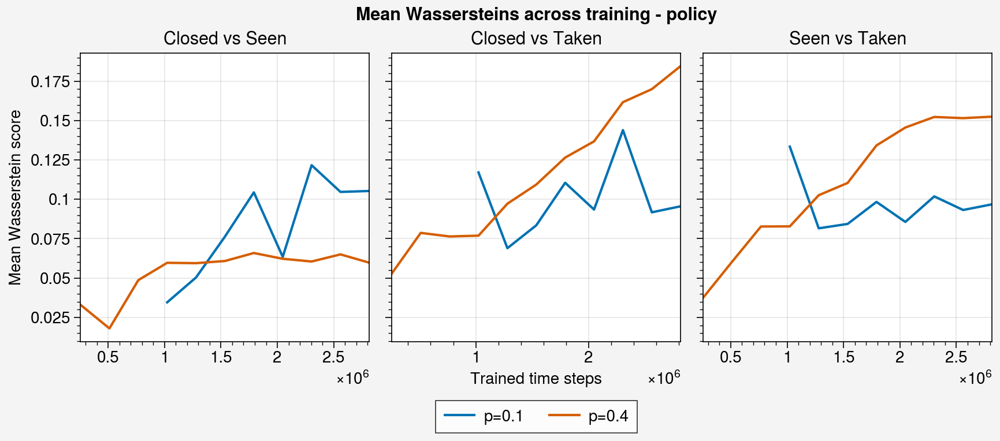

In [29]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/cst_wassersteins', 'rb'))
probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)


fig, ax = pplt.subplots(ncols=3)

labels = ['cvs', 'cvt', 'svt']
title = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']
for i, label in enumerate(labels):
    for p in probs:
        vals = []
        for t in trials:
            vals.append(wassersteins[f'{p}_{t}'][label])
        vals = np.nanmean(vals, axis=0)
        
        x = chks*64*100 if i == 2 else chks*64*100/1000000
        ax[i].plot(chks*64*100, vals, label=f'p={p}')
        
ax[1].legend(loc='b')
ax.format(xlabel='Trained time steps', ylabel='Mean Wasserstein score',
          title=title, suptitle='Mean Wassersteins across training - policy')

### Closed/Seen/Taken below corridor - copied v2

Draw the points in each

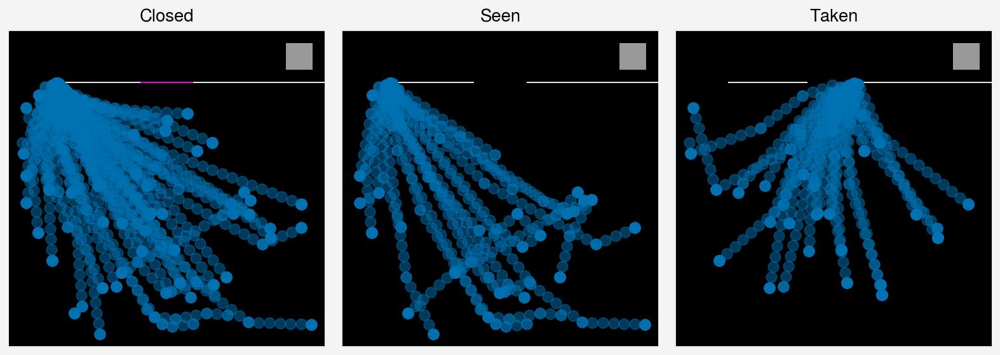

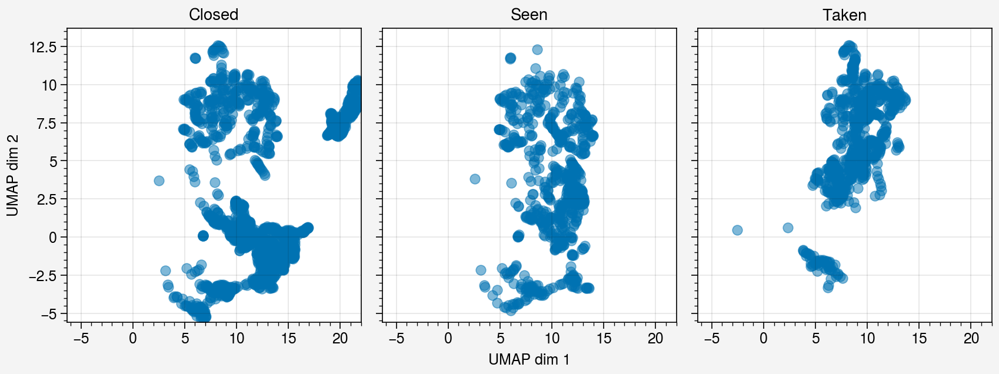

In [258]:
# cop_activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ', 'rb'))

res = cop_activs['0.4_0'][10]
pos = res['pos']
activ2d = res['activ2d']
xmin, ymin = activ2d.min(axis=0)
xmax, ymax = activ2d.max(axis=0)
used, avail = res['shortcut_used'], res['shortcut_avail']
colors = closed_seen_taken_coloring(pos, avail, used)

set_trajectory_plot_style()
fig, ax1 = pplt.subplots(ncols=3)
pplt.rc.reset()
fig, ax2 = pplt.subplots(ncols=3)

avails = [False, True, True]
for i in range(3):
    draw_shortcut_maze(avails[i], ax=ax1[i])
    p = np.vstack(pos)[colors == i]
    ax1[i].scatter(p[:, 0], p[:, 1], alpha=0.5)
    a = np.vstack(activ2d)[colors == i]
    ax2[i].scatter(a[:, 0], a[:, 1], alpha=0.5)
    
    
title = ['Closed', 'Seen', 'Taken']

ax1.format(xlim=[0, 300], ylim=[0, 300], title=title)
ax2.format(xlim=[xmin, xmax], ylim=[ymin, ymax], title=title,
          xlabel='UMAP dim 1', ylabel='UMAP dim 2')


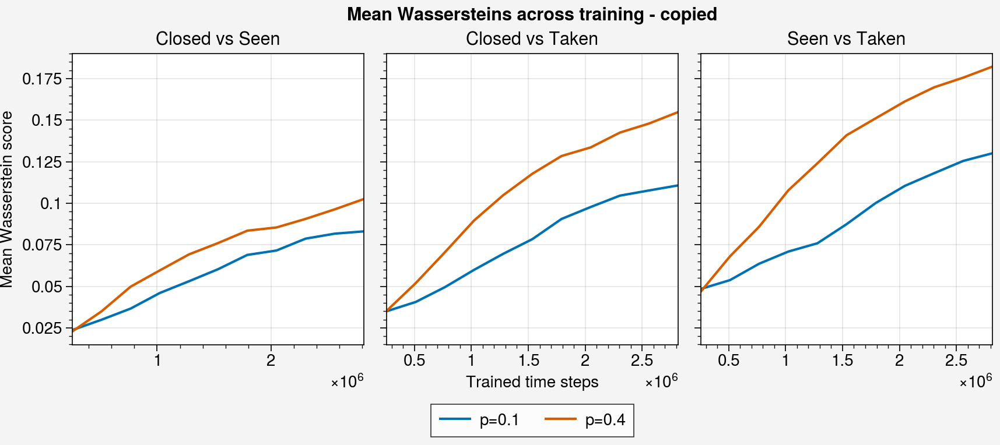

In [30]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/cst_wassersteins', 'rb'))
probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)


fig, ax = pplt.subplots(ncols=3)

labels = ['cvs', 'cvt', 'svt']
title = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']
for i, label in enumerate(labels):
    for p in probs:
        vals = []
        for t in trials:
            vals.append(wassersteins[f'{p}_{t}'][label])
        vals = np.nanmean(vals, axis=0)
        
        x = chks*64*100 if i == 2 else chks*64*100/1000000
        ax[i].plot(chks*64*100, vals, label=f'p={p}')
        
ax[1].legend(loc='b')
ax.format(xlabel='Trained time steps', ylabel='Mean Wasserstein score',
          title=title, suptitle='Mean Wassersteins across training - copied')

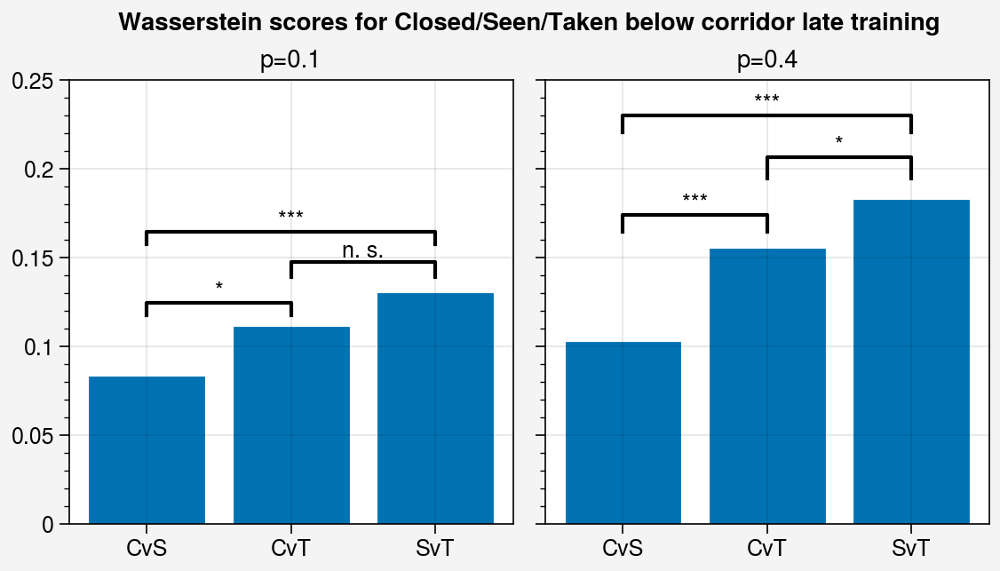

In [313]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/cst_wassersteins', 'rb'))
probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)


fig, ax = pplt.subplots(ncols=2)

labels = ['cvs', 'cvt', 'svt']
title = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']
xlabel = ['CvS', 'CvT', 'SvT']
for i, p in enumerate(probs):
    all_vals = []
    for label in labels:
        vals = []
        for t in trials:
            vals.append(wassersteins[f'{p}_{t}'][label][-1])
        
        all_vals.append(vals)
    ax[i].bar(np.arange(3), np.mean(all_vals, axis=1))
    
    for x, y in itertools.combinations(range(3), r=2):
        p = ttest_ind(all_vals[x], all_vals[y]).pvalue
        dh = 0.2 if x == 0 and y == 2 else 0.05
        barplot_annotate_brackets(x, y, p, range(3), np.mean(all_vals, axis=1), ax=ax[i], dh=dh)
    
ax.format(xlocator=range(3), xformatter=xlabel, title=[f'p={p}' for p in probs], ylim=[0, 0.25],
         suptitle='Wasserstein scores for Closed/Seen/Taken below corridor late training')



In [296]:
from scipy.stats import ttest_ind

def barplot_annotate_brackets(num1, num2, data, center, height, 
                              yerr=None, dh=.05, barh=.05, fs=None, 
                              maxasterix=3, ax=None):
    """ 
    Annotate barplot with p-values.

    :param num1: number of left bar to put bracket over
    :param num2: number of right bar to put bracket over
    :param data: string to write or number for generating asterixes
    :param center: centers of all bars (like plt.bar() input)
    :param height: heights of all bars (like plt.bar() input)
    :param yerr: yerrs of all bars (like plt.bar() input)
    :param dh: height offset over bar / bar + yerr in axes coordinates (0 to 1)
    :param barh: bar height in axes coordinates (0 to 1)
    :param fs: font size
    :param maxasterix: maximum number of asterixes to write (for very small p-values)
    """

    if type(data) is str:
        text = data
    else:
        # * is p < 0.05
        # ** is p < 0.005
        # *** is p < 0.0005
        # etc.
        text = ''
        p = .05

        while data < p:
            text += '*'
            p /= 10.

            if maxasterix and len(text) == maxasterix:
                break

        if len(text) == 0:
            text = 'n. s.'

    lx, ly = center[num1], height[num1]
    rx, ry = center[num2], height[num2]

    if yerr:
        ly += yerr[num1]
        ry += yerr[num2]

    ax_y0, ax_y1 = plt.gca().get_ylim()
    dh *= (ax_y1 - ax_y0)
    barh *= (ax_y1 - ax_y0)

    y = max(ly, ry) + dh

    barx = [lx, lx, rx, rx]
    bary = [y, y+barh, y+barh, y]
    mid = ((lx+rx)/2, y+barh)

    if ax is None:    
        plt.plot(barx, bary, c='black')
    else:
        ax.plot(barx, bary, c='black')

    kwargs = dict(ha='center', va='bottom')
    if fs is not None:
        kwargs['fontsize'] = fs

    if ax is None:
        plt.text(*mid, text, **kwargs)
    else:
        ax.text(*mid, text, **kwargs)
        

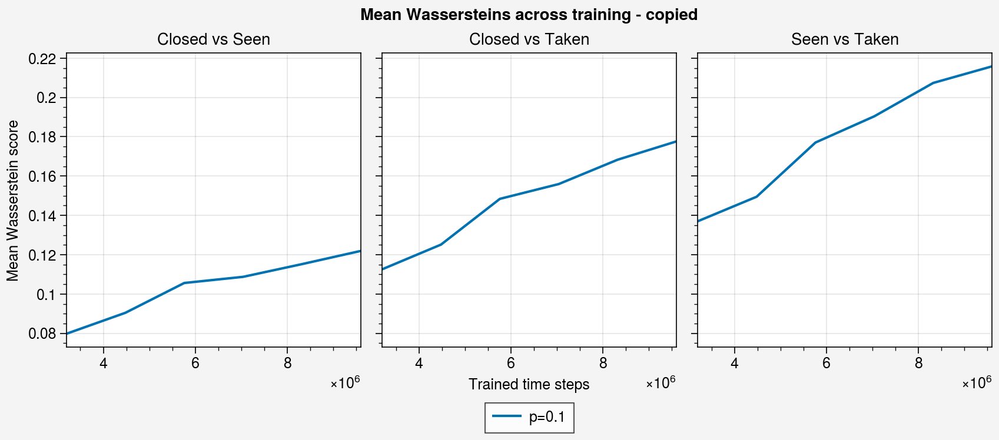

In [277]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/cst_wassersteins_longer', 'rb'))
# probs = [0.1, 0.4]
probs = [0.1]
trials = range(10)
chks = np.arange(500, 1560, 200)


fig, ax = pplt.subplots(ncols=3)

labels = ['cvs', 'cvt', 'svt']
title = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']
for i, label in enumerate(labels):
    for p in probs:
        vals = []
        for t in trials:
            vals.append(wassersteins[f'{p}_{t}_longer'][label])
        vals = np.nanmean(vals, axis=0)
        
        x = chks*64*100 if i == 2 else chks*64*100/1000000
        ax[i].plot(chks*64*100, vals, label=f'p={p}')
        
ax[1].legend(loc='b')
ax.format(xlabel='Trained time steps', ylabel='Mean Wasserstein score',
          title=title, suptitle='Mean Wassersteins across training - copied')

C:\Users\14and\AppData\Local\Temp\ipykernel_25028\3671597008.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)
C:\Users\14and\AppData\Local\Temp\ipykernel_25028\3671597008.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)
C:\Users\14and\AppData\Local\Temp\ipykernel_25028\3671597008.py:31: RuntimeWarning: Mean of empty slice
  w = np.nanmean(w_matrix, axis=0)


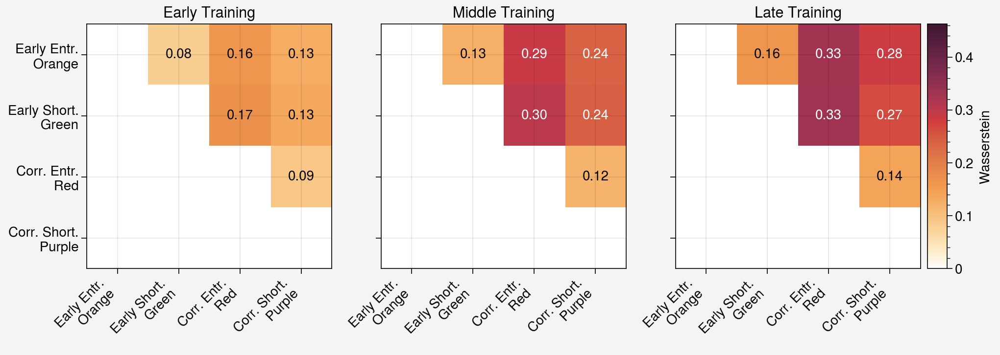

In [91]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/cst_wassersteins', 'rb'))

probs = [0.1, 0.4]
trials = range(10)

fig, ax = pplt.subplots(ncols=3)

# Get largest score to scale by
max_score = 0
for i, (p, t) in enumerate(itertools.product(probs, trials)):
    key = f'{p}_{t}'
    w = wassersteins[key][chk]
    if np.isnan(w).all():
        continue
    score = np.nanmax(w)
    if score > max_score:
        max_score = score


plot_chks = [1, 5, 10]
for n, chk in enumerate(plot_chks):
    
    # Gather up wasserstein scores to take a mean
    w_matrix = []
    for i, (p, t) in enumerate(itertools.product(probs, trials)):
        key = f'{p}_{t}'
        w = wassersteins[key][chk]
        if not np.isnan(w).all():
            w_matrix.append(w)
    w_matrix = np.stack(w_matrix)
    w = np.nanmean(w_matrix, axis=0)
    
    # plot matrix
    cbar = ax[n].imshow(w, vmin=0, vmax=max_score)

    for i, j in itertools.combinations(range(4), 2):
        score = w[i, j]
        color = 'white' if score > max_score/2 else 'black'
        ax[n].text(j, i, f'{score:.2f}', ha='center', va='center', color=color)

labels = ['Early Entr.\n Orange', 'Early Short.\n Green','Corr. Entr.\n Red', 'Corr. Short.\n Purple']
ax[-1].colorbar(cbar, label='Wasserstein')
ax.format(xformatter=labels, xlocator=range(5),
          xrotation=45,
          yformatter=labels, ylocator=range(5),
          title=['Early Training', 'Middle Training', 'Late Training'])


## Correlations with performance and training

### Green vs. Orange performance

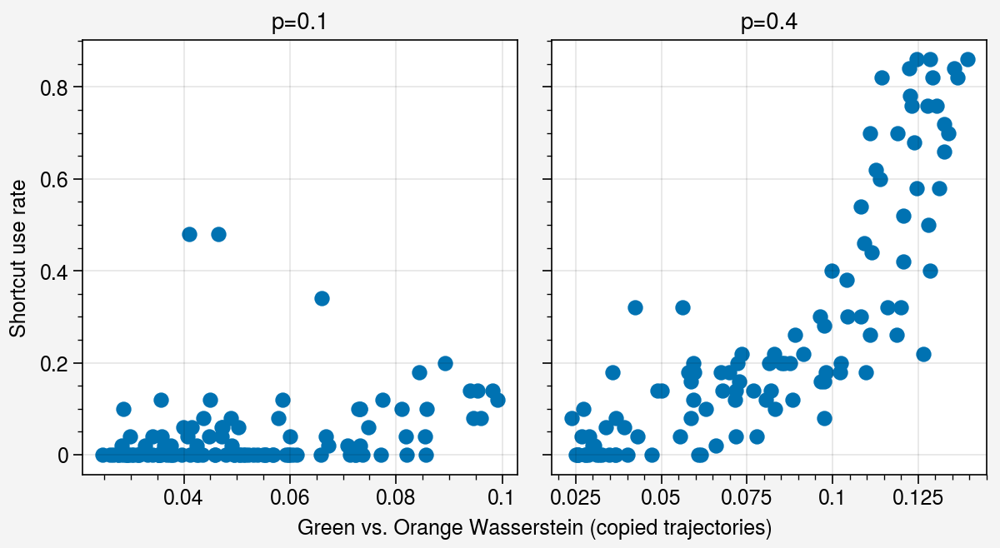

In [200]:
probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)

fig, ax = pplt.subplots(ncols=2, figwidth=6)
for i, p in enumerate(probs):    
    was = []
    surs = []
    ep_lens = []
    for t in trials:
        key = f'{p}_{t}'
        
        was.append(wassersteins[key])
        sur = []
        ep_len = []
        for chk in range(len(chks)):
            sur.append(np.sum(sur_activs[key][chk]['shortcut_used']) / 50)
            ep_len.append(np.mean([len(p) for p in sur_activs[key][chk]['pos']]))
        surs.append(sur)
        ep_lens.append(ep_len)
    was = np.array(was).flatten()
    surs = np.array(surs).flatten()
    ep_lens = np.array(ep_lens).flatten()
    
    ax[i].scatter(was, surs)
        
ax.format(xlabel='Green vs. Orange Wasserstein (copied trajectories)',
          ylabel='Shortcut use rate',
          title=[f'p={p}' for p in probs])


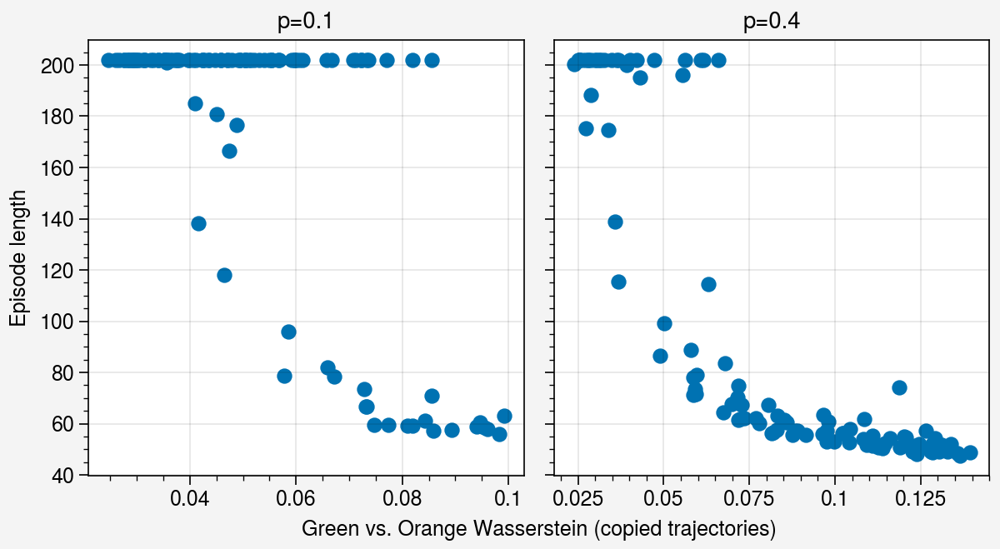

In [221]:
probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)

fig, ax = pplt.subplots(ncols=2, figwidth=6)
for i, p in enumerate(probs):    
    was = []
    surs = []
    ep_lens = []
    for t in trials:
        key = f'{p}_{t}'
        
        was.append(wassersteins[key])
        sur = []
        ep_len = []
        for chk in range(len(chks)):
            sur.append(np.sum(sur_activs[key][chk]['shortcut_used']) / 50)
            ep_len.append(np.mean([len(p) for p in sur_activs[key][chk]['pos']]))
        surs.append(sur)
        ep_lens.append(ep_len)
    was = np.array(was).flatten()
    surs = np.array(surs).flatten()
    ep_lens = np.array(ep_lens).flatten()
    
    ax[i].scatter(was, ep_lens)
        
ax.format(xlabel='Green vs. Orange Wasserstein (copied trajectories)',
          ylabel='Episode length',
          title=[f'p={p}' for p in probs])

### All cluster pairings (copied)

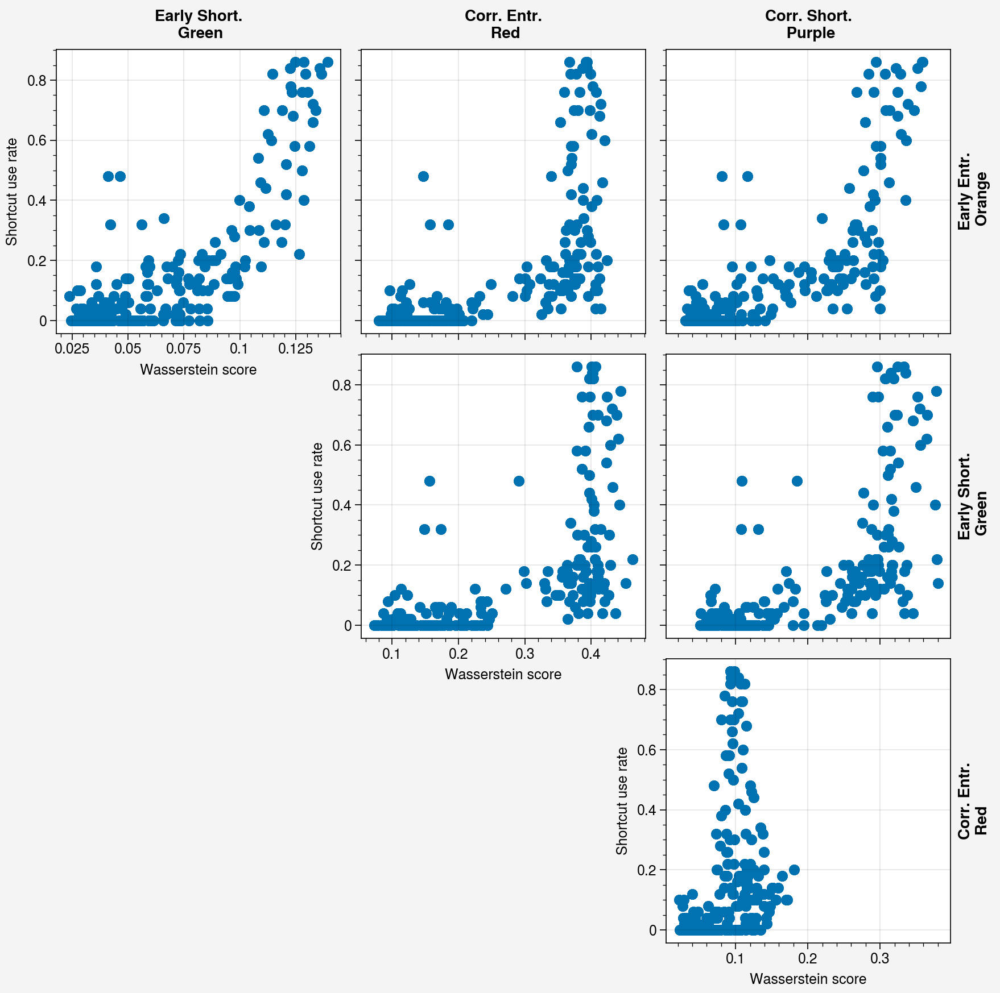

In [14]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/pair_wassersteins', 'rb'))
sur_activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

probs = [0.1, 0.4]
trials = range(10)

array = [
    [1, 2, 3],
    [0, 4, 5],
    [0, 0, 6],
]
fig, ax = pplt.subplots(array)

count = 0
for i, j in itertools.combinations(range(4), 2):
    was = []
    surs = []
    ep_lens = []
    for p, t in itertools.product(probs, trials):
        for t in trials:
            key = f'{p}_{t}'

            was.append(wassersteins[key][:, i, j])
            sur = []
            ep_len = []
            for chk in range(len(chks)):
                sur.append(np.sum(sur_activs[key][chk]['shortcut_used']) / 50)
                ep_len.append(np.mean([len(p) for p in sur_activs[key][chk]['pos']]))
            surs.append(sur)
            ep_lens.append(ep_len)
    was = np.array(was).flatten()
    surs = np.array(surs).flatten()
    ep_lens = np.array(ep_lens).flatten()

    ax[count].scatter(was, surs)
    count += 1
labels = ['Early Entr.\n Orange', 'Early Short.\n Green','Corr. Entr.\n Red', 'Corr. Short.\n Purple']
ax.format(toplabels=labels[1:],
         rightlabels=labels[:-1],
         xlabel='Wasserstein score',
         ylabel='Shortcut use rate')



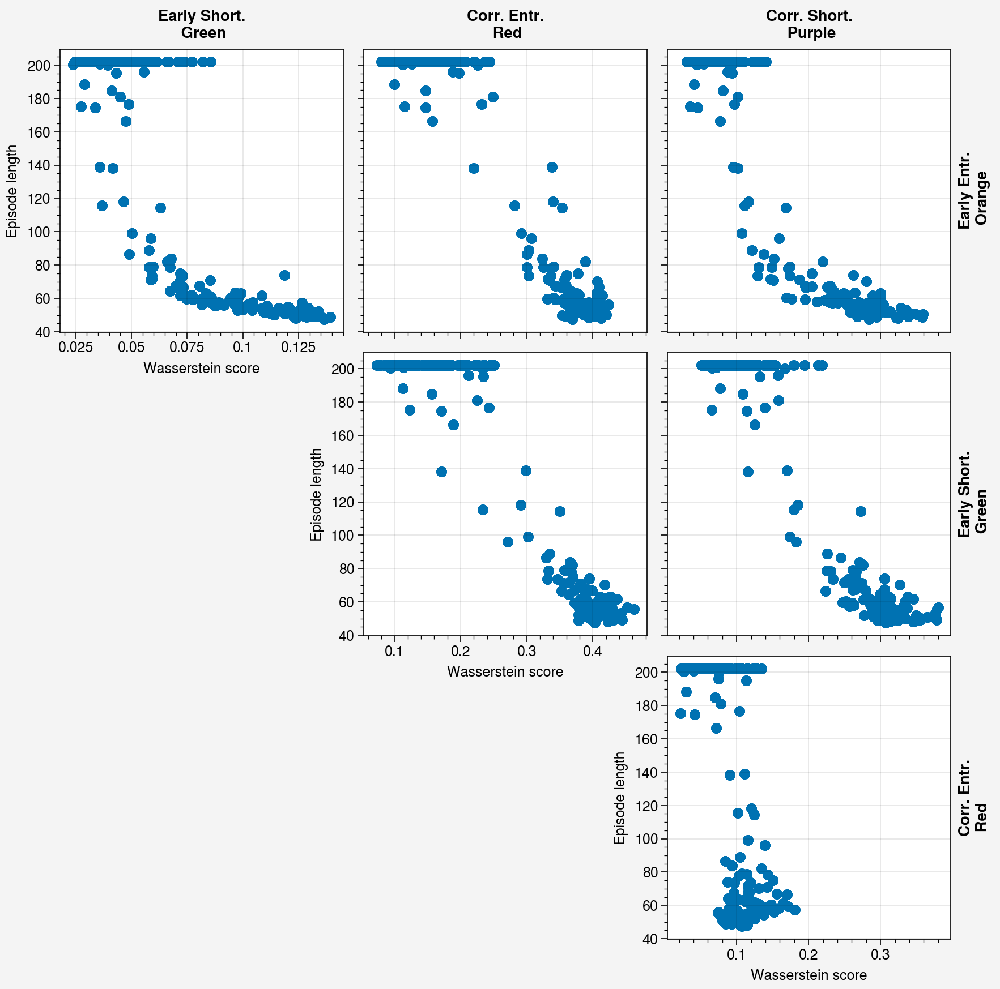

In [17]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/pair_wassersteins', 'rb'))
sur_activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

probs = [0.1, 0.4]
trials = range(10)

array = [
    [1, 2, 3],
    [0, 4, 5],
    [0, 0, 6],
]
fig, ax = pplt.subplots(array)

count = 0
for i, j in itertools.combinations(range(4), 2):
    was = []
    surs = []
    ep_lens = []
    for p, t in itertools.product(probs, trials):
        for t in trials:
            key = f'{p}_{t}'

            was.append(wassersteins[key][:, i, j])
            sur = []
            ep_len = []
            for chk in range(len(chks)):
                sur.append(np.sum(sur_activs[key][chk]['shortcut_used']) / 50)
                ep_len.append(np.mean([len(p) for p in sur_activs[key][chk]['pos']]))
            surs.append(sur)
            ep_lens.append(ep_len)
    was = np.array(was).flatten()
    surs = np.array(surs).flatten()
    ep_lens = np.array(ep_lens).flatten()

    ax[count].scatter(was, ep_lens)
    count += 1
labels = ['Early Entr.\n Orange', 'Early Short.\n Green','Corr. Entr.\n Red', 'Corr. Short.\n Purple']
ax.format(toplabels=labels[1:],
         rightlabels=labels[:-1],
         xlabel='Wasserstein score',
         ylabel='Episode length')



### All cluster pairings (policy, correlation scores)

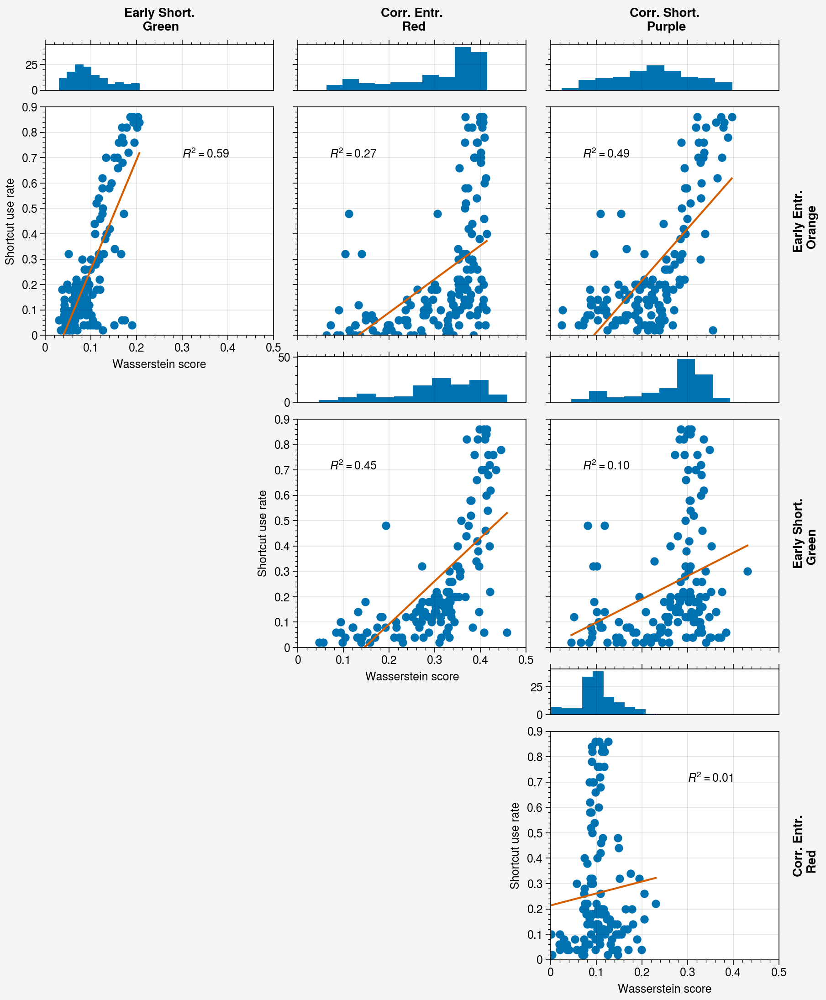

In [40]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/pair_wassersteins', 'rb'))
sur_activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

probs = [0.1, 0.4]
trials = range(10)

array = [
    [1, 2, 3],
    [0, 4, 5],
    [0, 0, 6],
]
fig, ax = pplt.subplots(array)
tax = ax.panel_axes('t')

count = 0
for i, j in itertools.combinations(range(4), 2):
    was = []
    surs = []
    ep_lens = []
    for p, t in itertools.product(probs, trials):
        key = f'{p}_{t}'

        was.append(wassersteins[key][:, i, j])
        sur = []
        ep_len = []
        for chk in range(len(chks)):
            sur.append(np.sum(sur_activs[key][chk]['shortcut_used']) / 50)
            ep_len.append(np.mean([len(p) for p in sur_activs[key][chk]['pos']]))
        surs.append(sur)
        ep_lens.append(ep_len)
    was = np.array(was).flatten()
    surs = np.array(surs).flatten()
    ep_lens = np.array(ep_lens).flatten()
    
    ax[count].scatter(was, surs)
    x, y, r2 = linear_bestfit(was[~np.isnan(was)], surs[~np.isnan(was)])
    ax[count].plot(x, y)
    
    x = 0.3 if count in [0, 5] else 0.07
    ax[count].text(x, 0.7, f'$R^2={r2:.2f}$')
    
    tax[count].hist(was)
    count += 1
    
labels = ['Early Entr.\n Orange', 'Early Short.\n Green','Corr. Entr.\n Red', 'Corr. Short.\n Purple']
ax.format(toplabels=labels[1:],
         rightlabels=labels[:-1],
         xlabel='Wasserstein score',
         ylabel='Shortcut use rate',
         xlim=[0, 0.5], ylim=[0, 0.9])



# Purple vs. Red, top right half

Focusing on only the right half of the corridor, we check whether purple and red separation is even less clear here. We can also measure whether there is correlation between some population activity measures and the distance along the corridor

In [148]:
activs = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/shared1_activ', 'rb'))

num_chks = len(activs['0.4_0'])

wassersteins = {}
for key in tqdm(activs):
    chk_res = activs[key]
    wassersteins[key] = {'cvs': [], 'cvt': [], 'svt': []}
    n_to_id = ['cvs', 'cvt', 'svt'] # convert enumeration in itertools combination
        # loop to the correct key in wassersteins dict
    
    for chk, res in enumerate(chk_res):
        pos = res['pos']
        avail = res['shortcut_avail']
        used = res['shortcut_used']
        color = closed_seen_taken_corridor(pos, avail, used)
        activ = np.vstack(res['activ'])
                    
        for n, (i, j) in enumerate(itertools.combinations(range(3), 2)):
            if (color == i).sum() < 1 or (color == j).sum() < 1:
                score = np.nan
            elif (color == i).sum() > 4000 and (color == j).sum() > 4000:
                score = np.nan # too many comparisons, will be very slow
            else:
                score = two_cloud_wasserstein(activ[color == i],
                                             activ[color == j],
                                             all_data=activ)[0]
            wassersteins[key][n_to_id[n]].append(score)
            
pickle.dump(wassersteins, open('data/shortcut/wc1.5_policy_moreagents/cst_corridor_wassersteins', 'wb'))

100%|████████████████████████████████████████████████████████████████████████████| 20/20 [00:14<00:00,  1.41it/s]


### Copied v2

In [149]:
activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ', 'rb'))

num_chks = len(activs['0.4_0'])

wassersteins = {}
for key in tqdm(activs):
    chk_res = activs[key]
    wassersteins[key] = {'cvs': [], 'cvt': [], 'svt': []}
    n_to_id = ['cvs', 'cvt', 'svt'] # convert enumeration in itertools combination
        # loop to the correct key in wassersteins dict
    
    for chk, res in enumerate(chk_res):
        pos = res['pos']
        avail = res['shortcut_avail']
        used = res['shortcut_used']
        color = closed_seen_taken_corridor(pos, avail, used)
        activ = np.vstack(res['activ'])
                    
        for n, (i, j) in enumerate(itertools.combinations(range(3), 2)):
            if (color == i).sum() < 1 or (color == j).sum() < 1:
                score = np.nan
            elif (color == i).sum() > 4000 and (color == j).sum() > 4000:
                score = np.nan # too many comparisons, will be very slow
            else:
                score = two_cloud_wasserstein(activ[color == i],
                                             activ[color == j],
                                             all_data=activ)[0]
            wassersteins[key][n_to_id[n]].append(score)
            
pickle.dump(wassersteins, open('data/shortcut/wc1.5_copiedv2_moreagents/cst_corridor_wassersteins', 'wb'))

100%|████████████████████████████████████████████████████████████████████████████| 20/20 [00:23<00:00,  1.19s/it]


### Copied v2 - longer

In [269]:
activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ_longer', 'rb'))

chks = np.arange(500, 1560, 200)
num_chks = len(chks)

wassersteins = {}
for key in tqdm(activs):
    chk_res = activs[key]
    wassersteins[key] = {'cvs': [], 'cvt': [], 'svt': []}
    n_to_id = ['cvs', 'cvt', 'svt'] # convert enumeration in itertools combination
        # loop to the correct key in wassersteins dict
    
    for chk, res in enumerate(chk_res):
        pos = res['pos']
        avail = res['shortcut_avail']
        used = res['shortcut_used']
        color = closed_seen_taken_corridor(pos, avail, used)
        activ = np.vstack(res['activ'])
                    
        for n, (i, j) in enumerate(itertools.combinations(range(3), 2)):
            if (color == i).sum() < 1 or (color == j).sum() < 1:
                score = np.nan
            elif (color == i).sum() > 4000 and (color == j).sum() > 4000:
                score = np.nan # too many comparisons, will be very slow
            else:
                score = two_cloud_wasserstein(activ[color == i],
                                             activ[color == j],
                                             all_data=activ)[0]
            wassersteins[key][n_to_id[n]].append(score)
            
pickle.dump(wassersteins, open('data/shortcut/wc1.5_copiedv2_moreagents/cst_corridor_wassersteins_longer', 'wb'))

100%|████████████████████████████████████████████████████████████████████████████| 10/10 [00:06<00:00,  1.48it/s]


### Closed/Seen/Taken above corridor - policy

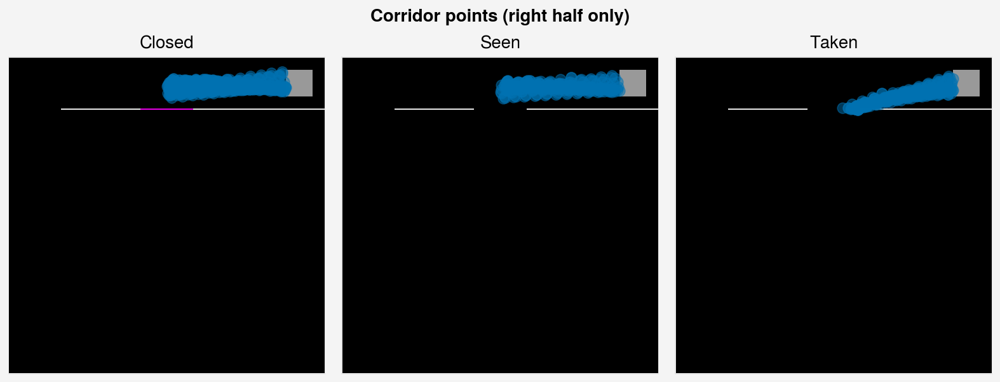

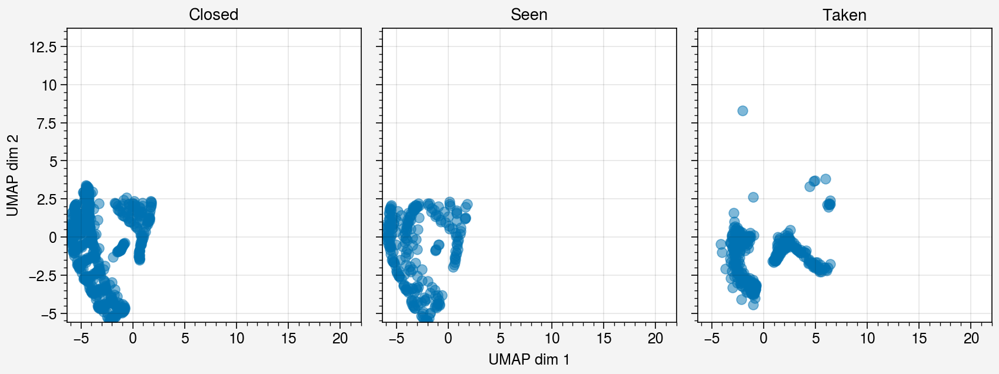

In [260]:
# cop_activs = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/shared1_activ', 'rb'))

res = cop_activs['0.4_0'][10]
pos = res['pos']
activ2d = res['activ2d']
xmin, ymin = activ2d.min(axis=0)
xmax, ymax = activ2d.max(axis=0)
used, avail = res['shortcut_used'], res['shortcut_avail']
colors = closed_seen_taken_corridor(pos, avail, used)

set_trajectory_plot_style()
fig, ax1 = pplt.subplots(ncols=3)
pplt.rc.reset()
fig, ax2 = pplt.subplots(ncols=3)

avails = [False, True, True]
for i in range(3):
    draw_shortcut_maze(avails[i], ax=ax1[i])
    p = np.vstack(pos)[colors == i]
    ax1[i].scatter(p[:, 0], p[:, 1], alpha=0.5)
    a = np.vstack(activ2d)[colors == i]
    ax2[i].scatter(a[:, 0], a[:, 1], alpha=0.5)
    
    
title = ['Closed', 'Seen', 'Taken']

ax1.format(xlim=[0, 300], ylim=[0, 300], title=title,
           suptitle='Corridor points (right half only)')
ax2.format(xlim=[xmin, xmax], ylim=[ymin, ymax], title=title,
          xlabel='UMAP dim 1', ylabel='UMAP dim 2')


C:\Users\14and\AppData\Local\Temp\ipykernel_22360\2637110258.py:16: RuntimeWarning: Mean of empty slice
  vals = np.nanmean(vals, axis=0)


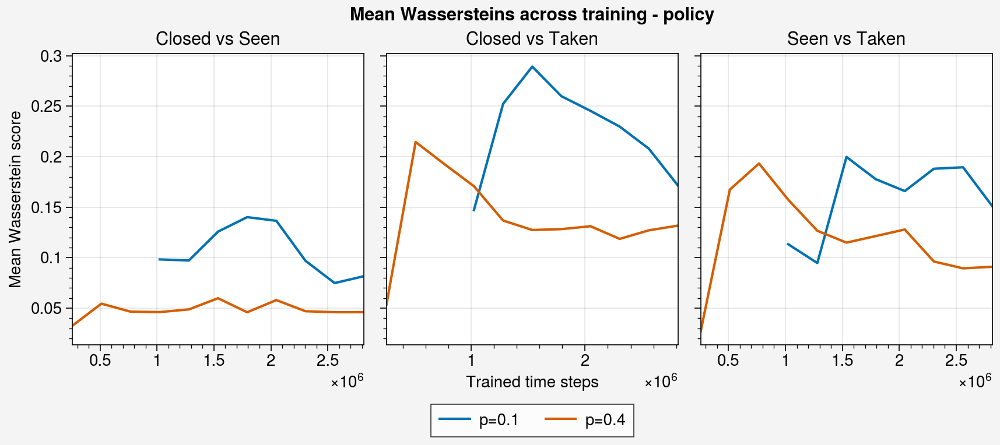

In [150]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_policy_moreagents/cst_corridor_wassersteins', 'rb'))
probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)


fig, ax = pplt.subplots(ncols=3)

labels = ['cvs', 'cvt', 'svt']
title = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']
for i, label in enumerate(labels):
    for p in probs:
        vals = []
        for t in trials:
            vals.append(wassersteins[f'{p}_{t}'][label])
        vals = np.nanmean(vals, axis=0)
        
        x = chks*64*100 if i == 2 else chks*64*100/1000000
        ax[i].plot(chks*64*100, vals, label=f'p={p}')
        
ax[1].legend(loc='b')
ax.format(xlabel='Trained time steps', ylabel='Mean Wasserstein score',
          title=title, suptitle='Mean Wassersteins across training - policy')

### Closed/Seen/Taken above corridor - copied v2

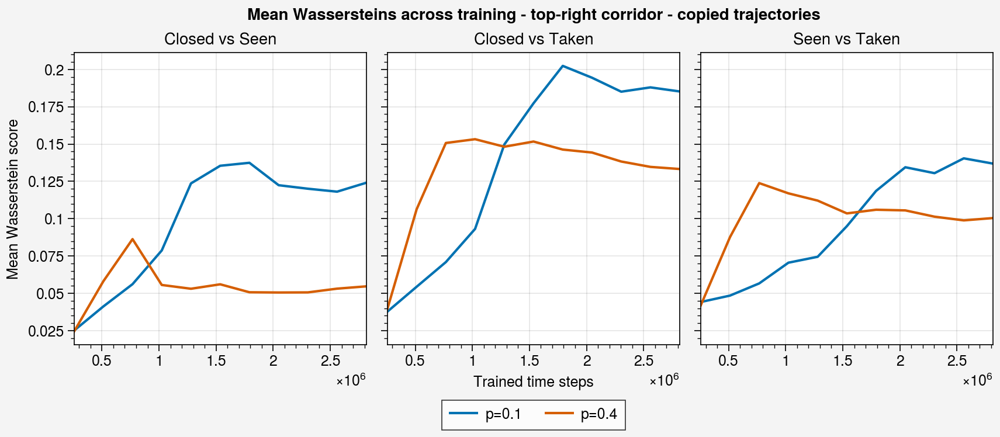

In [275]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/cst_corridor_wassersteins', 'rb'))
probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)


fig, ax = pplt.subplots(ncols=3)

labels = ['cvs', 'cvt', 'svt']
title = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']
for i, label in enumerate(labels):
    for p in probs:
        vals = []
        for t in trials:
            vals.append(wassersteins[f'{p}_{t}'][label])
        vals = np.nanmean(vals, axis=0)
        
        x = chks*64*100 if i == 2 else chks*64*100/1000000
        ax[i].plot(chks*64*100, vals, label=f'p={p}')
        # print(vals)
        
ax[1].legend(loc='b')
ax.format(xlabel='Trained time steps', ylabel='Mean Wasserstein score',
          title=title, suptitle='Mean Wassersteins across training - top-right corridor - copied trajectories')

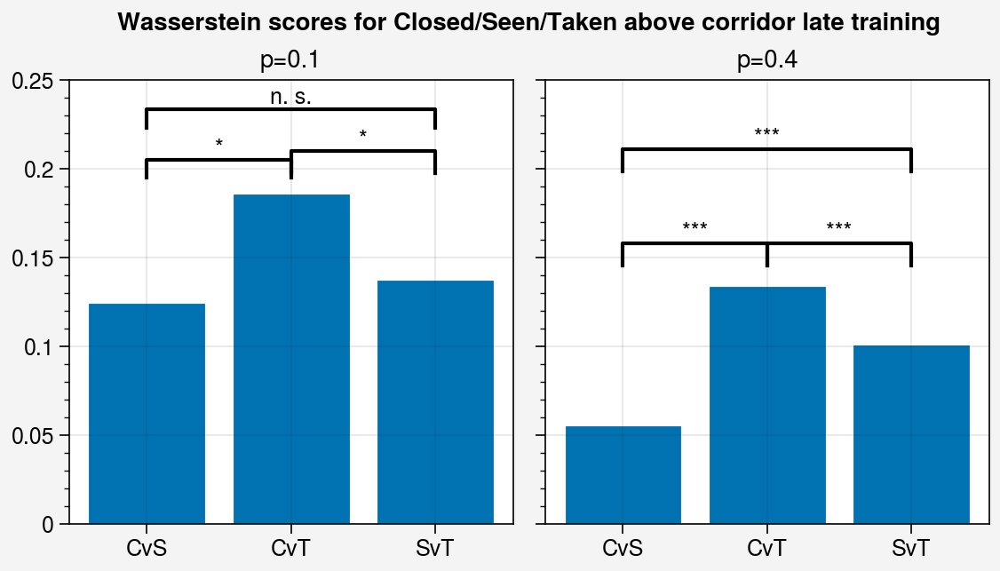

In [317]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/cst_corridor_wassersteins', 'rb'))
probs = [0.1, 0.4]
trials = range(10)
chks = np.arange(40, 470, 40)


fig, ax = pplt.subplots(ncols=2)

labels = ['cvs', 'cvt', 'svt']
title = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']
xlabel = ['CvS', 'CvT', 'SvT']
for i, p in enumerate(probs):
    all_vals = []
    for label in labels:
        vals = []
        for t in trials:
            vals.append(wassersteins[f'{p}_{t}'][label][-1])
        
        all_vals.append(vals)
    ax[i].bar(np.arange(3), np.mean(all_vals, axis=1))
    
    for x, y in itertools.combinations(range(3), r=2):
        p = ttest_ind(all_vals[x], all_vals[y]).pvalue
        dh = 0.4 if x == 0 and y == 2 else 0.05
        barplot_annotate_brackets(x, y, p, range(3), np.mean(all_vals, axis=1), ax=ax[i], dh=dh)
    
ax.format(xlocator=range(3), xformatter=xlabel, title=[f'p={p}' for p in probs], ylim=[0, 0.25],
         suptitle='Wasserstein scores for Closed/Seen/Taken above corridor late training')



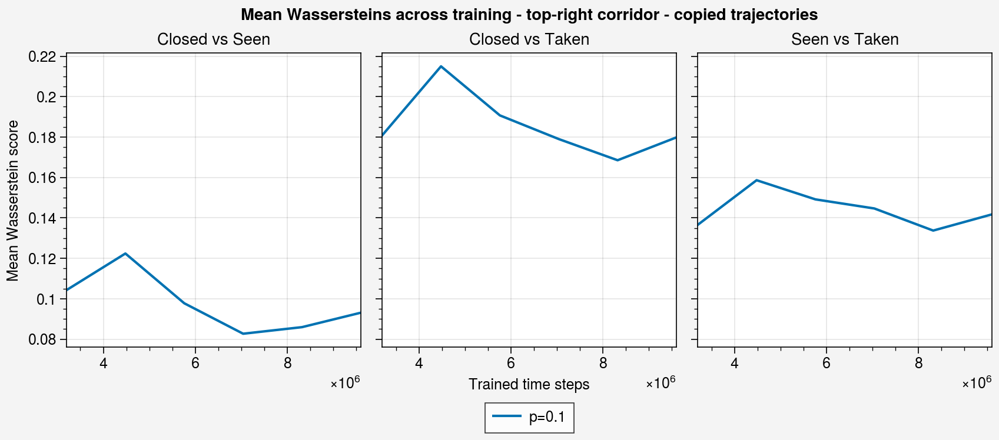

In [276]:
wassersteins = pickle.load(open('data/shortcut/wc1.5_copiedv2_moreagents/cst_corridor_wassersteins_longer', 'rb'))
# probs = [0.1, 0.4]
probs = [0.1]
trials = range(10)
chks = np.arange(500, 1560, 200)


fig, ax = pplt.subplots(ncols=3)

labels = ['cvs', 'cvt', 'svt']
title = ['Closed vs Seen', 'Closed vs Taken', 'Seen vs Taken']
for i, label in enumerate(labels):
    for p in probs:
        vals = []
        for t in trials:
            vals.append(wassersteins[f'{p}_{t}_longer'][label])
        vals = np.nanmean(vals, axis=0)
        
        x = chks*64*100 if i == 2 else chks*64*100/1000000
        ax[i].plot(chks*64*100, vals, label=f'p={p}')
        # print(vals)
        
ax[1].legend(loc='b')
ax.format(xlabel='Trained time steps', ylabel='Mean Wasserstein score',
          title=title, suptitle='Mean Wassersteins across training - top-right corridor - copied trajectories')

In [272]:
vals

array([0.13658208, 0.15865232, 0.14917015, 0.1446764 , 0.13374509,
       0.14177554])

In [158]:
res = activs['0.4_0'][9]
activ = np.vstack(res['activ'])
pos = res['pos']
used, avail = res['shortcut_used'], res['shortcut_avail']
labels = closed_seen_taken_corridor(ep_pos=pos, ep_shortcut_avail=avail, ep_shortcut_used=used)

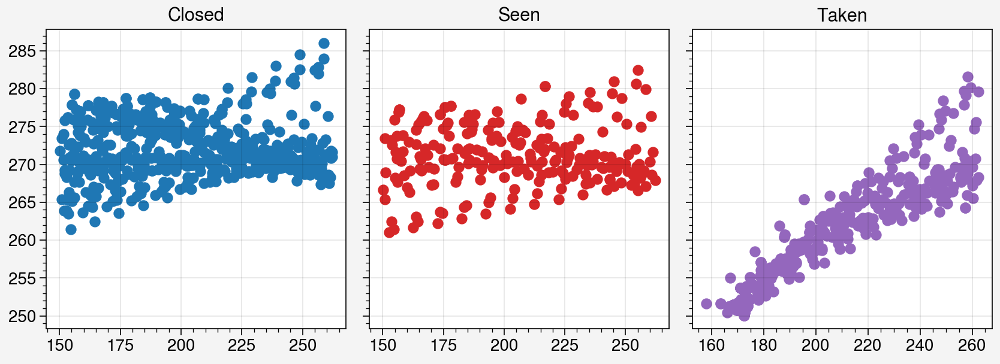

In [159]:
pos = np.vstack(pos)
blue = pos[labels == 0]
red = pos[labels == 1]
purple = pos[labels == 2]
fig, ax = pplt.subplots(ncols=3)
ax[0].scatter(blue[:, 0], blue[:, 1], color=rgb_colors[0])
ax[1].scatter(red[:, 0], red[:, 1], color=rgb_colors[3])
ax[2].scatter(purple[:, 0], purple[:, 1], color=rgb_colors[4])

ax.format(title=['Closed', 'Seen', 'Taken'])